# Введение

In [1]:
from IPython.display import Audio
Audio('Total Self-Hatred.mp3')

$f(x, w) \to y$. x -  текст на русском, y - текст на английском. Надо подобрать w так, чтобы качество f было наилучшим.  
$\text{студент}\to \text{оценка за МО-1}$. То, что анализируем - объект. Пространство объектов $\mathbb{X}$  
Ответ, целевая переменная, target - то, что предсказываем, оцениваем. Пространство ответов - $\mathbb{Y}$.  
$\mathbb{Y} \in [0, 10], \mathbb{R}$. Обучающая выборка - набор объектов, для которого мы знаем правильные ответы, $X = (x_i, y_i), \ell - \text{размер выборки}$.  
data drift: обучающая выборка, часто - исторические данные, которые часто имеют оч мало отношение к наличной реальности.  
`Data drift is unexpected and undocumented changes to data structure, semantics, and infrastructure that is a result of modern data architectures`  
Признаки, факторы, feutuves - характеристики объектов.  
1) Числовые, $x_i \in \mathbb{R}$. Гпа, рост, вес, возраст, доля посещенных лекций.
2) Категориальные. $x_i \in {\{c1, \dots, c_m\}}$. С какой образовательной программы, способ поступления. С ними ничего нельзя делать.
3) Порядковые признаки.  $x_i \in {\{c1, \dots, c_m\}}$. Есть порядок, операция сравнения.

* concept drift — изменение зависимости между признаками и таргетом. Например, если вы делаете музыкальные рекомендации, вам нужно будет учитывать и появление новых треков, и изменение вкусов аудитории.

__Тип задачи определяется__ $\mathbb{Y}$
### Обучение с учителем. supervided learning. Есть целевая переменная. По факту мы умеем решать только это...
1. $Y\in\mathbb{R}$ -  регрессия.
2. $|\mathbb{Y}| < \inf$ - классификация  
$\mathbb{Y} = {\{0, 1\}}$ - бинарная классификация.  
$\mathbb{Y} = {\{1, \dots, k\}}$ - многокласовая классификация.  
$\mathbb{Y} = {\{0, 1\}}^k$ - классификация с пересекающимися классами.
3. Ранжирование  
$\cdots$
### Обучение без учителя.  unsupervised learning.  
- Нет целевой переменной
1. Кластеризация.  
$X \to$ надо разбить на подмножество, чтобы в каждом из них объекты были похожи  
Сложно интерпретировать, скорее всего содержательно может быть нихуя.
2. Оценивание плотности.  
Есть еще:  
* Частичное обучение
* Обучение с подкреплением. RL

__Модель, алгоритмы__  
a: $\mathbb{X} \to \mathbb{Y}$  
a(x) $\approx$ y  
$a(x) = w_0 + w_1 x_1 + w_2 x_2 + \dots + w_d x_d$  
можно записать полином  
Модели:  
1. Дифференцируемые
2. Недифференцируемые (реш. деревья)  

Семейсво моделей: $A = \{a(x, w) | w\}$  
Подбираем коэффиценты, параметры через функцию потерь  
$L: \mathbb{Y}*\mathbb{Y} \to R$  
$L(y, z) = (y - z)^2$. y - правильный ответ, z - выход модели.  
Через функцию потерь задаем требования к модели.  
То, что считаем на целой выборке - $Q(a, X)$ - функционал (то, что принимает на вход функцию) ошибки (бывает функционал качества).  
$Q(a, X) = \frac{1}{\ell} \sum {v_i *L(y_i, a(x_i))}$, где $v_i$ - веса.  
Обучение модели: $Q(a, x) \to \min_{a\in d}$  
X, L, A $\to a_{*}$ мы надеемся, что на новых данных это тоже будет хорошо работать.

__Этап решения задачи в ML__
1. Постановка задачи
2. Сбор данных
3. Разработка признаков
4. Подготовка данных
5. Выбор функции потерь
6. Выбор семейства модели
7. Обучение модели
8. Валидация модели (офлайн, валидация)
9. Внедрение модели и эксплуатация 

$X_{train}$ - 80%  
$X_{test}$ - 20%  
Кросс-валидация: дробим выборку на фолды. Выбираем одного как тест, остальное трейн и так тестируем на каждом.

# Линейные модели

__Как устроены?__  
$\mathbb{Y} = R$  
$\mathbb{X} = R^{\alpha}$ - все признаки вещественные. $x = \{x_1, \dots, x_{\alpha}\}$  
$a(x) = w_0 + w_1x_1 + \dots + w_{alpha}x_{alpha}$ - лин. модель регрессии.  
$x = \begin{bmatrix}
    x_1 \\
    x_2 \\
    \vdots \\
    x_{\alpha}
    \end{bmatrix}
\in R^{\alpha} $    $w = \begin{bmatrix}
    w_1 \\
    w_2 \\
    \vdots \\
    w_{\alpha}
    \end{bmatrix}
\in R$  
$a(x) = w_0 + <w, x>$  
Предположение: в моих данных гарантированно есть константный признак.  
$\to a(x) = <w, x>$




__Применение линейных моделей__  
- признаки влияют на прогноз `независимо`
- признаки влияют линейно  
$\to$  для линейных моделей данные надо готовить  



__Категориальные признаки__  
$x_j \in \{c_1, \dots, c_m\}$ - категориальный.  
One-hot encoding (OHE): мы заменяем один категориальный признак на столько бинарный, сколько было значений у этого признака.  
$x_j \to b_1(x_j), \dots, b_m(x_j)$  
$b_i(x_j) = [x_i = c_i]$ (индикатор)  
$a(x) + w_0 + w_1[хамовники]+w_2[басманный]$  

__Дискретизация признаков__  
Допустим, что данные распределены нихуя не линейно. А давайте разобьем данные на m порогов ($t_i$).  
$x_j \to b_i(x_j). b_i(x_j) = [t_{i-1} \leq x_j < t_i]$  
$a(x) = w_0 + w_1[t_{0} \leq x_j < t_1] + w_2[t_{1} \leq x_j < t_2] + \dots + w_m[t_{m-1} \leq x_j < t_m]$.  
Для каждой области модель будет линейна, а вот для всей выборки в целом - кусочно-линейной

__Полиномиальные признаки__  
Площадь, этаж, расстояние.  

Добавим все мономы до 2-й степени: $x_1 ^2, x_2 ^2, x_3 ^2, x_1 x_2, x_1 x_3, x_2 x_3$. Можно корни, синус, логарифмы. Но непонятно, что из всего этого брать.

__Измерение ошибки в задачах регрессии__  
$L(y, x) - \text{функция потерь от правильного ответа и прогноза}$.  $Q(a, X) = \frac{1}{\ell} \sum L(y_i, a(x_i))$ функционал ошибки.  

`MSE`  
$L(y, z) = (y - z)^2$  
$Q(a, X) = \frac{1}{\ell} \sum(a(x_i) - y_i)^2$  
- ошибку получаем в квадратных единицах
- Получаем $\mathbb{E}(y | x)$.  

`RMSE`  
$=\sqrt{MSE}$ - так лучше. По значению RMSE без контекста нельзя понять хорошая ли модель.  
$R^2 = 1 - \frac{\sum(a(x_i) - y_i)^2}{\sum (\bar y - y_i)^2}$ - коэф. детерминации. Кста, если у нас только intercept, то $R^2$ будет ноль.  

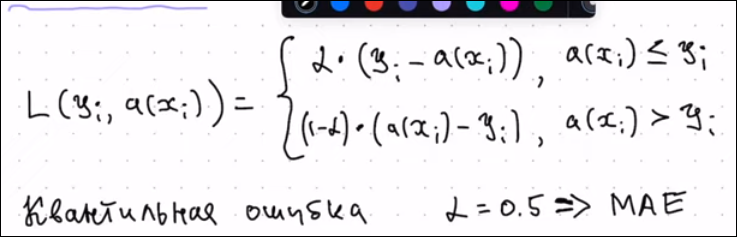  
прогнозирует квантиль уровня $\alpha$  

`MAE`  
$L(y,z) = |y - z|$  
$Q(a, X) = \frac{1}{\ell} \sum |a(x_i) - y_i|$  
Нахуя, если квадрат и модуль это почти одно и то же? Допустим, у нас есть какие-то выбросы в target. Квадрат оч круто завышает потери при выбросах и стимулирует подгонку к ним. MAE лучше реагирует на выбросы.  
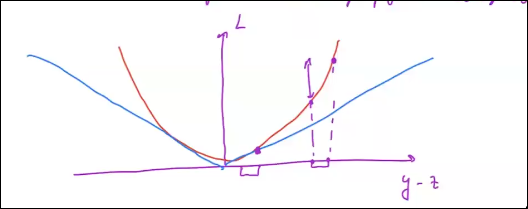  
- Поч не использовать всегда MAE?
1. Где-то может быть важно фокусироваться на больших ошибках.
2. По градиенту MSE можно понять как далеко мы от оптимума, а вот у MAE нельзя. Сложность в оптимизации.

`Huber loss`
$\begin{equation}
L_{\delta} = 
 \begin{cases}
   \frac{1}{2} (y - z)^2 &\ |y - z| < \delta \\
   \delta (|y - z| - \frac{1}{2}\delta) &\ |y - z| \geq \delta
 \end{cases}
\end{equation}$  
Ну то есть, если развыв маленький, то квадрат, если большой, то модуль. Есть проблема со второй производной 


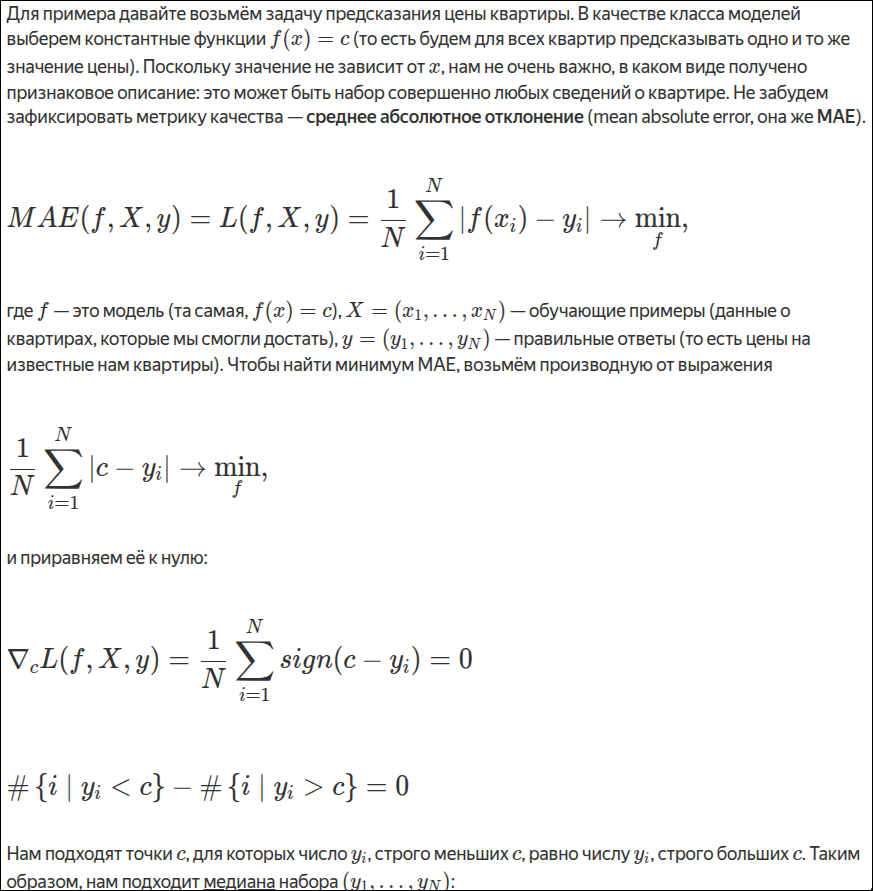

__Регуляризация__  

$Q(w) = \frac{1}{\ell} \sum {L(y_i, a(x_i))} + \lambda *R(w) \to min_w$  
$MSE + R(w) = \sum {w_{k}^2} - \ell_2$ - Ridge  
$MSE + R(w) = \sum {|w_{k}|} - \ell_1$ - Lasso (помогает отбирать признаки)  
Пример:  
$$y=wx$$
$$Q(w) = \frac{1}{\ell} \sum(y_i - wx_i)^2 + \lambda w^2 \to min_w$$  
$$\frac{\partial{Q}}{\partial{w}} = -\frac{2}{\ell} \sum{(y_i - wx_i)}x_i + 2\lambda w = 0$$  
$$w = \frac{\sum{y_i x_i}}{\sum{x^2 _i} +n \lambda}$$  
При увеличении $\lambda$ w убывает.  
W - параметр, по которому берется производная  
а $\lambda$ - гиперпараметр, берем из головы. Grid Search, Random Search.   
`Grid Search`. Допустим, у нас два гиперпараметра: $\lambda$ и deg(a(x)).  
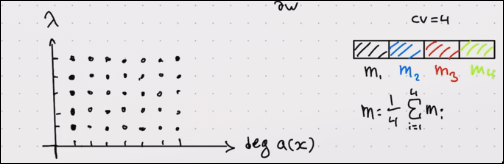  
Проходимся по каждой точке. Используем кросс-валидацию. Обучаем модель, поделив выборку на n фолдов. Каждая выдает какое-то значение и далее мы выбираем среднее:  
m = $\frac{1}{n} \sum{m_i}$  
`Random Search`. Точки на сетке мы выбираем рандомно  
__!Регуляризация не включает в себя $w_0$!__

`Модификафикация huber loss: LogCosh`  
$L(y, z) = \log{\cosh{(y - z)}}$. $\cosh$ похож на huber loss, но вторая производная хорошая. Производная оч похожа на сигмоиду с центром с 0. То есть сначала она квадратичная, потом почти линейна  

`MSLE`  
$y \geq 0, z \geq 0$, тогда $(\log{(y + 1)} - \log{(z + 1)})^2$ - штраф за отличие в порядок.  

`Относительная функция потерь`  
* $L(y, z) = |\frac{y - z}{y}|$.  
$100\% * \frac{1}{\ell} \sum{|\frac{y_i - a(x_i)}{y_i}|}$ - MAPE. Интерпретация оч проста. Хороши при разных масштабах Y.  
$MAPE = \frac{1}{\ell} \sum{\frac{1}{|y_i|} |a(x_i) - y_i|}$. Ну то есть это типо MAE, но у которой появляются веса
* $|\frac{y_i - a(x_i)}{(|y_i| + |z|)/2}|$ - SMAPE. MAPE скашивает модель в сторону недопрогнозирования, а SMAPE в данном смысле симметрична  
* Квантильная функция потерь. $L(y, z) = (\tau - 1)[y - z < 0](y - z) + \tau[y - z \geq 0](y - z)$, $\tau \in (0, 1)$  
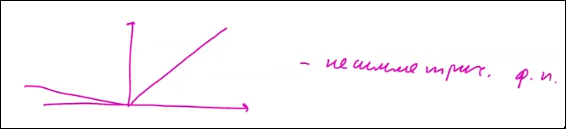  


__Переобучение__  
* Есть эффект двойного спуска при росте числа параметров.
* Переобучение: ситуация, когда модель получает хорошие показатели на трейне, но на тесте ужастно, то есть мы модель подогнали под трейн и она неспособна работать на иных данных.  
Ошибка на новых данных > ошибки на обучающей выборке.
* Антоним - обобщающая способность модели (generalization).

__Оценка о.с.__  
1. Отложенная выборка. hold-out set.  
Отрезаю от данных кусочек и на ней проверяю.  
Допустим, мы обучаем много моделей. Тогда ты треним на обучающей, смотрим лучшую на валидационной и финал - тест, где мы проверяем лучшую из валидации.  
Какого размера отложенная выборка?  
- Обучающая выборка должна быть по-больше.
- Тестовая выборка должна быть репрезентативной.  
Пропорции: 80 20, 70 30, 80 10 10, 70 20 10.  
От рандома зависит узнаем ли мы специфику наших данных или нет.
2. Кросс-валидация (cross validation, CV).  
k - число  блоков, фолдов. Разбиваем выборку на фолды... бла-бла-бла очев знаешь демдальш. Качество - среднее на каждом разбиении.
- Если $k=\ell$ - LOO (leave-one-out), считается лучшим способом обучения модели. Но есть минус - обучать модель $\ell$ раз.
Что делать дальше?
1. Обучаем новую модель уже на всех данных
2. $x \to mean (a_i(x))$
Если данных много, то CV вряд ли пригодится. Требует обучения k моделей. И все равно требует тестовую выборку

__Обучение линейных моделей__  
Пусть обучается на MSE:  
$\frac{1}{\ell} \sum{(<w, x_i> - y_i)^2} \to min_w$  
$X_{l\, \times\, d} = 
\begin{bmatrix}
    x_{1 1} \  x_{1 2} \dots x_{1 d}\\
    x_{2 1} \  x_{2 2} \dots x_{2 d}\\
    \vdots \\
    x_{\ell 1} \  x_{\ell 2} \dots x_{\ell d} \\
\end{bmatrix}
$  

$w_{d} = 
\begin{bmatrix}
w_1 \\
\vdots \\
w_d \\
\end{bmatrix}
$

$y_{\ell} = 
\begin{bmatrix}
y_1 \\
\vdots \\
y_{\ell} \\
\end{bmatrix}
$

$x_{\ell \times 1} = 
\begin{bmatrix}
<w, x_1> \\
\vdots \\
<w, x_{\ell}> \\
\end{bmatrix}
$  

$Q(w) = \frac{1}{\ell}||X_{w} - y||^2 \to min_w$
Чтобы проминимизировать нужно продифференцировать:  
$$\nabla Q(w) = 0$$  
$$w_x = (X^{T} X) ^{-1} X^{T} y$$

__Проблемы__  
1. Матрица, которую мы обращаем, может быть вырожденна
2. Обращение $X^{T} X: O(d^3)$
3. Если окажется, что  $L(y, z)$ хитрая, то может оказаться невозможным $\nabla Q(w) = 0$


# Градиентые методы обучения    
$Q(w_1, \dots, w_d)\to min$. Если Q дифференцируема  
$$\nabla Q(w_1, \dots, w_d) = 
\begin{bmatrix}
\frac{\partial{Q}}{\partial{w_1}} \\  
\
\frac{\partial{Q}}{\partial{w_d}} \\
\end{bmatrix}$$
Есть несколько важных свойств. Как вектор показывает направление наискорейшего роста в точке w.  
1. Если взять с минусом, но направление наискорейшего убывания, логично.  
2. Вектор градиента всегда ортогонален линии уровня.  
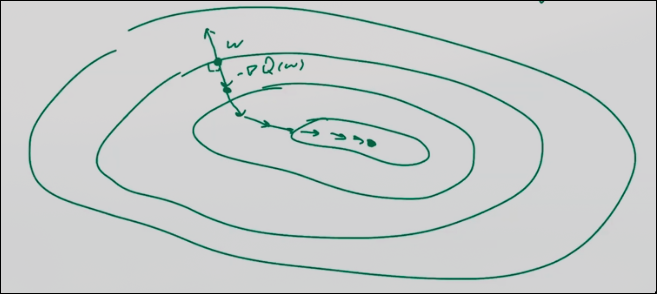  

`Такой метод называется градиентным спуском.`  
1. Берем какую-то случайную инициализацию $w^{0}$
2. Шаг:  $$w^{k}= w^{k - 1} - \eta *\nabla Q(w^{k - 1})$$
$\eta - \text{learning rate}$. 
 
Останавливаемся, если:  
1. $||\nabla Q(w ^{k})|| < \epsilon$
2. $||w^{k} - w^{k - 1}|| < \epsilon$
3. $|Q(w^{k}) - Q(w^{k - 1})| < \epsilon$
4. k > N
5. `Идеал`: если ошибка на валидации перестала убывать.  

`Замечания:`  
1. Локальный минимум.  
'Решение': сделать мультистарт = сделать много спусков. Гарантий не попадания в лок.минимум нет))
2. Много разных условий сходимости. 

`Теорема`.
- Если $Q(w)$ -  выпуклая, дифф. 
- $\nabla Q(w)$ - липшицев.  
$||\nabla Q(w_1) - \nabla Q(w_2)|| \leq L * ||w_1 - w_2||$. Липшевцевость значает, что функция изменяется не очень быстро.
- $\eta$ не очень большая ($\leq \frac{1}{L}$). L (Липшицева константа), чем больше тем более вариантивна функция, чем больше, тем меньше надо шагать.  
3. Если все условия выполнены, то гр.спуск. сойдется к минимуму.  
4. C лин.моделями и адекватными функциями потерь $Q(w)$ почти всегда выпуклый
5. $Q(w^{k}) - Q(w^{*}) = O(\frac{1}{k})$, k - номер итерации.  
Но такой ванильный гр.спуск работает так себе. 

__Оценивание градиента__  
$Q(w) = \frac{1}{\ell} \sum{L(y_i, a(x_i, w))}$, $L(y_i, a(x_i, w)) = q_i(w)$.  
$Q(w) = \frac{1}{\ell} \sum{q_i(w)}$.  
$\nabla Q(w) = \frac{1}{\ell} \sum{\nabla q_i(w)}$.  
GD медленный на больших данных, так как операций $l \times d$  

`Стохастический гр.спуск (SGD)`.  
Скажем, что среднее по $\ell$ слагаемым мы оценим одним слагаемым.
$$\nabla Q(w) \approx \nabla q_i (w)$$
Шаг SGD:  
$i_k$ -  случ.индекс объекта (семплируем из равномерного распределение от 1 до $\ell$).  
$w^{k} = w^{k - 1} - \eta \nabla q_i (w^{k - 1})$.  
Проблема: если $||w^{k} - w^{*}|| >> 0, \text{ то } \nabla q_{i_{k}} (w) \approx \nabla Q(w)$, если $||w^{k} - w^{*}|| \approx 0, \text{ то } \nabla q_{i_{k}} (w) \neq \nabla Q(w)$  

`Уменьшаем шаг`  
$w^{k} = w^{k - 1} - \eta_{k}\: \nabla q_i (w^{k - 1})$  
Требование (условия Роббинса-Монро):  
$\sum {\eta_k} = \infty$  
$\sum \eta_k ^2 < \infty$  
$\eta_k = \lambda (\frac{s_0}{s_0 + k})^p.\;\; p, s_0, \lambda \text{  - надо подбирать}$  
Скорость сходимости: $\mathbb{E} (Q(w^{k}) - Q(w^{*})) = O\frac{1}{\sqrt{k}}$  
Область асцилирования, то есть то, насколько ошибка SGD (он не сходится) - порядка Var($\nabla{Q}$)  
$E(g(x, n) - \nabla f(x))^2 \leq \sigma^2$  
SVGR
$g(x^k) = \nabla{f_k}(x^2) - \nabla{f_k(w)} + \nabla{f(w)}$. $\nabla{f(w)}$ - обновляется раз в эпоху

`Замечания`:  
1. Есть mini-batch GD (есть исследование, что надо брать m не более 32)
2. SGD хорош для онлайн обучения (получаем объекты последовательно)
3. Эпоха - $\ell$ операций. Один проход по выборке в GD  

`SAG (stochastic average gradient)`  
$Q(w) = \frac{1}{\ell} \sum{q_i(w)}$  
$z_i ^{0} = \nabla q_i(w^{0})$  
итерация SAG: $i_k$ - пикаю объект, пересчитываем $z_i ^{k}$  
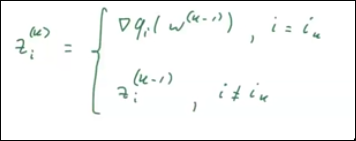 
$\nabla Q(w^{k - 1}) \approx \frac{1}{\ell} \sum z^{k} _i$  
$w^{k} = w^{k - 1} - \eta \; \frac{1}{\ell} \sum{z_i ^{k}}$  
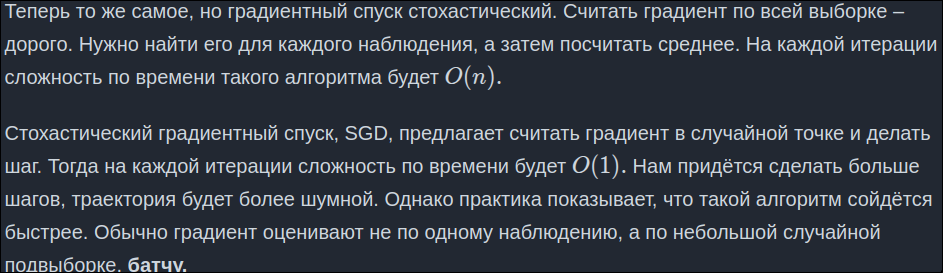  


`Метод инерции (momentum)`  
У нас ситуация, когда линии уровня какие-то вытянутые, тогда нас будет шатать оч сильно и оч долго. А давайте будем шагать не по градиенту, а по сумме градиентов из прошлых шагов. Проблема осцилляций.  
$w^{0}$ -  инициализация.  
$h_0 = 0$ - вектор инерции.  
Шаг:  
$h_k = \alpha h_{k - 1} + \eta \nabla Q(w^{k - 1})$. $\alpha \in (0, 1)$. Можно сделать замену на оценку градиента. $w^{k} = w^{k - 1} - h_k$  
  
- Есть Нестеров momentum  
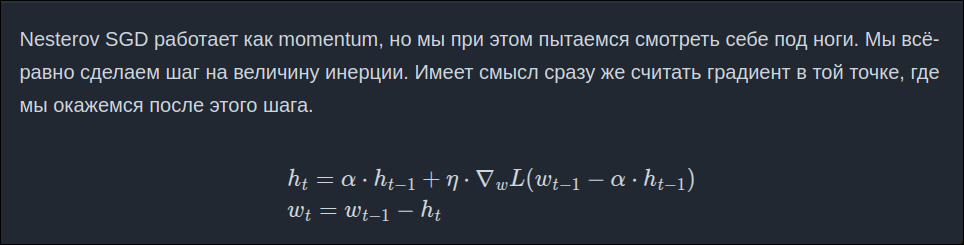  
 

`Адаптивный шаг`  
Задача разряженная. По какому-то параметру мы недообучились.  

`AdaGrad`:  
$G_{0, j} = 0$, j - номер параметра. $G_{k,\;j} = G_{k - 1, \; j} + (\nabla Q(w^{k - 1}))^2 _j$. То есть я считаю насколько сильно мы уже обучили $w_j$.  
$w^{k} _j = w^{k - 1}_j - \frac{\eta_k}{\sqrt{G_{k, i}} + \epsilon} (\nabla Q(w^{k - 1}))_j$  
Проблема: $G_{k, j}$ только растет и может остановить обучение. Тогда модификация:  

`RMSProp`  
* $G_{k,\;j} = \alpha * G_{k - 1, \; j} + (1 - \alpha)*(\nabla Q(w^{k - 1}))^2 _j$  
`ВСЕ ЭТО ВЫПУКЛАЯ ОПТИМИЗАЦИЯ, ЕСЛИ НЕВЫПУКЛАЯ, ТО ПРИМЕНЯЕМ НА СВОЙ СТРАХ И РИСК`  

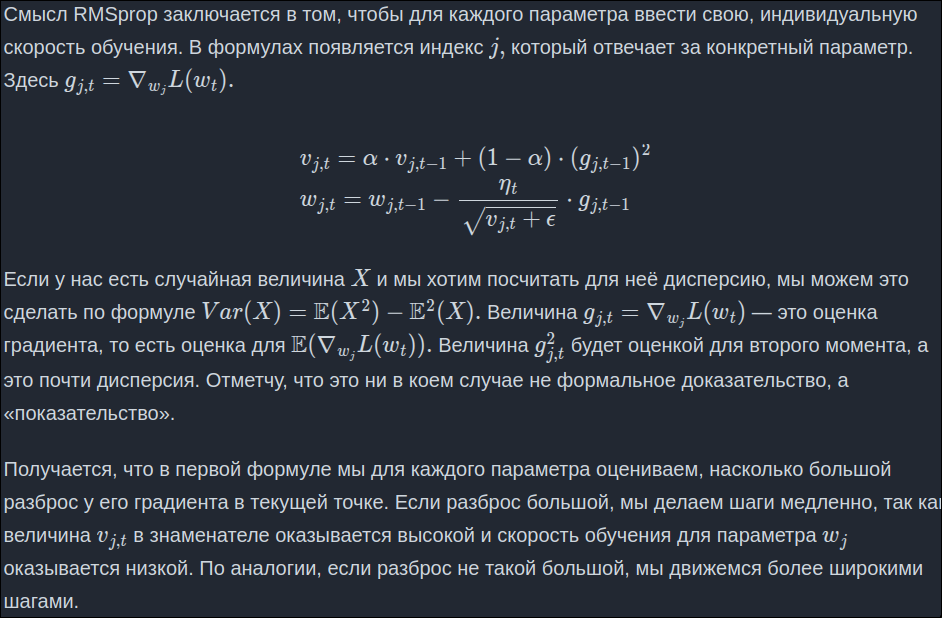 

`Adam`
  
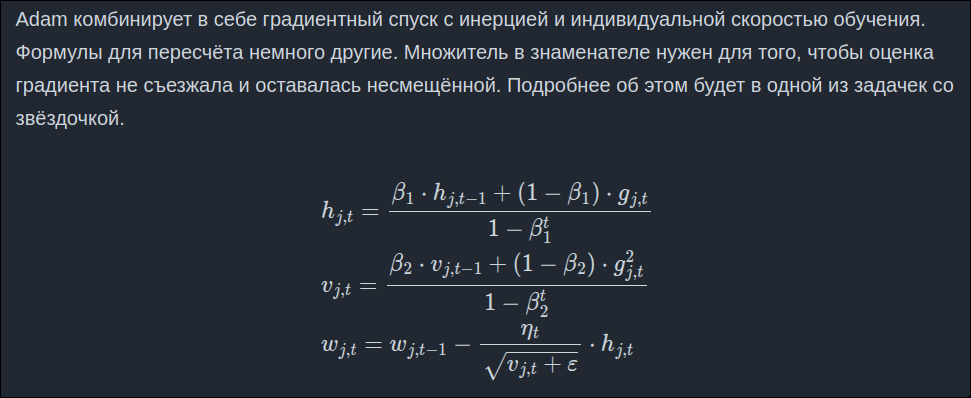  


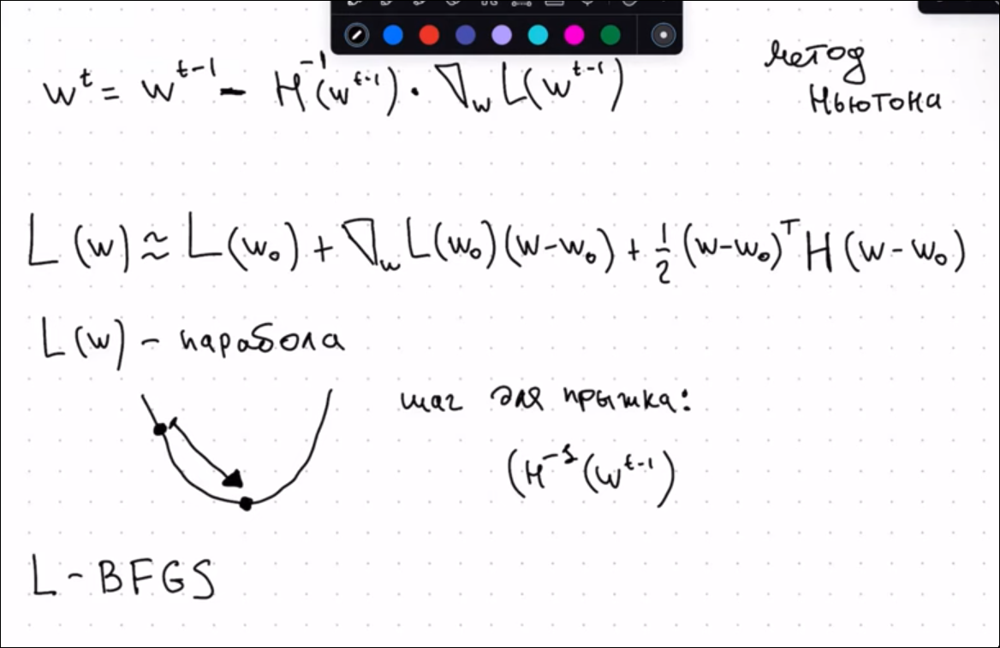

# Преобразование над данными  
__Числовые признаки, проблемы__  
1. Выбросы  
Лечение:  
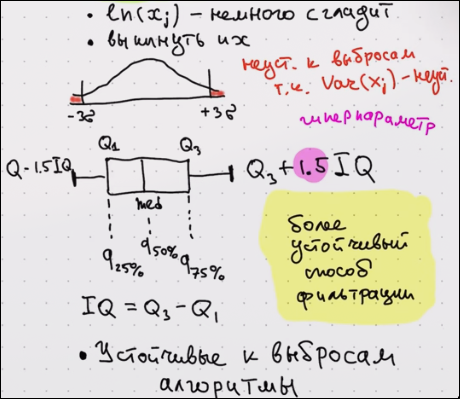  
2. Мультиколлинеарность  
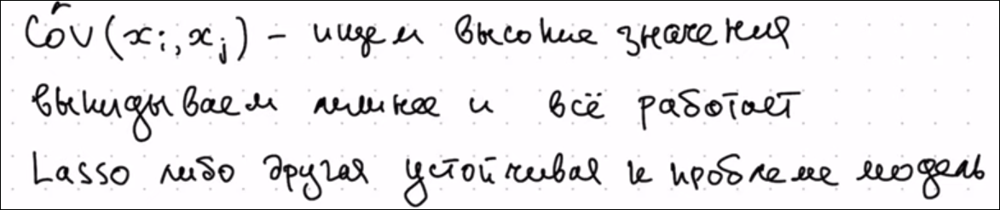  
3. Разный масштаб  
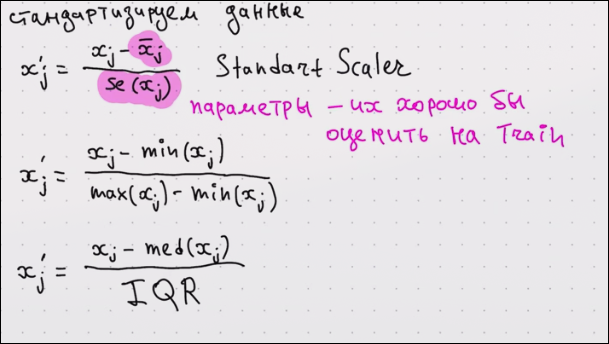  
4. Пропуски в данных  
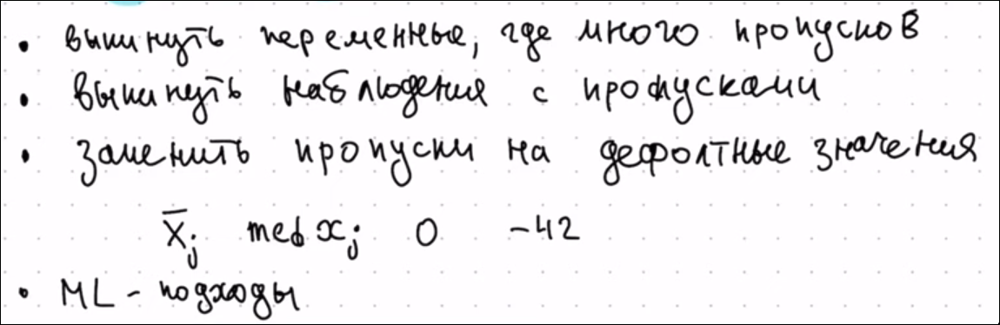  

__Категориальные переременные__  
1. Label/Ordinal Encoding (плохой вариант)
2. One-hot encoding (бинаризация)
3. Target Encoding.  
- Mean Encoding: $x_i = \frac{\sum{y_i} [x_i = k]}{\sum{[x_i = k]}}$. Кодирование можно придумать по одному наблюдению, какая-то хуйня...  
- Регуляризация: $$x_i = \frac{\sum{y_i} [x_i = k] + \frac{\lambda}{n} \sum{y_i}}{\sum{[x_i = k]} + \lambda}$$
если лямбда большая, то я перетягиваю больше к среднему, если маленькая, то каждое значение будет более уникальным
- Weight of Evidence. Заменяем на логарифм шансов: $\log(\frac{\mathbb{P}(x_i = k|y = +1)}{\mathbb{P}(x_i = k | y = -1)})$  
$$\mathbb{P} (x_i = k | y = b) = \frac{\sum {[y_i = b][x_i = k] + \lambda}}{\sum{[y_i = b]} +2\lambda}$$
Может оч легко получиться переобучение. Можно использовать кросс-валидацию

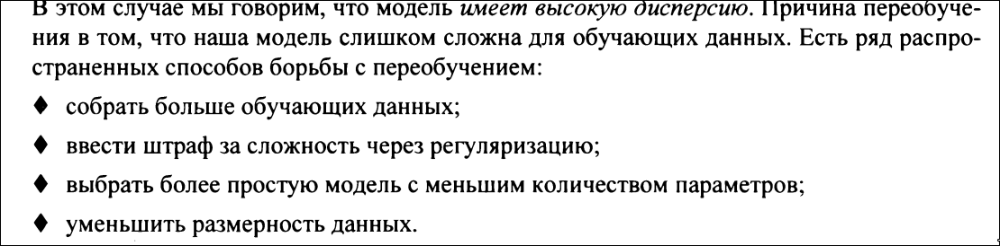

# Регуляризация

* Известный экспериментальный факт: если лин. модели переобучена, то у нее, почти всегда, большие веса. В обратную сторону это тоже работает: большие веса, обычно, это плохо. Модель получается гуперчувствительная к изменению в признаках, а это не соответствует тому, как работает мир.

* Модели легко обучиться с большими весами.  
Типичная ситуация: у выборки есть лин. зависимые признаки. $\to \exist v \in R^d : \forall x \in \mathbb{X} \;\;\; <v, x> = 0$  
$w_x - \text{решения.    } \frac{1}{\ell} \sum {(<w, x_i> - y_i)^2}\to \min$  
$<w_{*} + \alpha v, x>\; = \;<w_{*}, x> + \alpha <v, x> (=0)$. Параметры можно брать какие угодно и все будет решением. То есть модели запросто может получить большие веса.

* Идея: запретить большие веса. $$Q(w) - \text{ функционал ошибки   }. \;\;Q(w) + R(w) \text{ (регуляризатор)   } \to \min$$
$R(w) = ||w||^2_2 = \sum {w^2 _j}- L_2$  
$R(w) = ||w||_1 = \sum {|w| _j}- L_1$  
$\alpha - \text{    коэф.регуляризации  }$. Ее нельзя подбирать по обучающей выборке, это `гиперпараметр`. Есть разные стратегии подбора: Gread Search, Random Search, AutoML.  
Кстати, регуляризация лучше сходится по гр.спуску.  
Ridge: $w_{*} = (X^T X + \alpha I) ^{-1} X^T y$. С.з у матрицы под  $^{-1}$ точно больше нуля => точно есть решения.  
Lasso: зануляет часть признаков.

__Замечания__  
1. Допустим, мы смотрим зависимость цены от площадии. В среднем цена у нас 10^7. Дохуя... Но это не про чувствительность модели => `w0 не включается в регуляризацию!!!`.
2. Пусть у нас неотмасштабированная выборка. У нас есть маленький коэф ($10^{-5}$) и большой ($0.01$). И за первый коэф мы штрафуем больше чисто из-за разницы в масштабе, что плохо. Регуляризатор плохо себя ведет при немасштабируемых признаках.
3. Добавление регуляризации ускоряет гр.спуск, так как упрощает рельеф функционала 

# Разреженные модели  
Зачем занулять часть весов?  
1. Мы накидали в признаки все подряд.
2. Ускорение моделей
3. $\ell << d$. Объектов сильно меньше количества признаков. Решение: L1 регуляризация  

Объяснения:
- $Q(w) + \lambda ||w||_1 \to \min$. Можно перевести в условный вид: $Q(w) \to \min, \;\;\;\; ||w||_1 \leq \;c$, выполнено для какого-то c.  
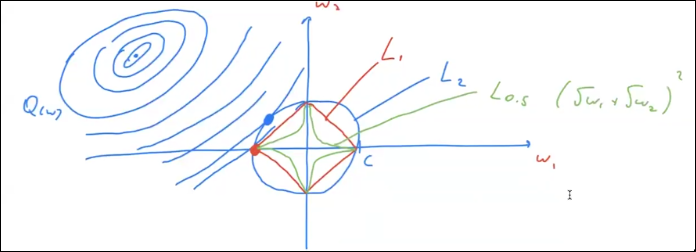  
- L2: $w(1, \epsilon)$. $(||w - (\delta, 0)||)^2 _2= 1 - 2\delta + \delta^2 + \epsilon^2$. $0 < \delta < \epsilon << 1$  
L1: $w(1, \epsilon)$. $(||w - (\delta, 0)||)_1 = 1 - \delta + \epsilon$  
L2: $w(1, \epsilon)$. $(||w - (0, \delta)||)^2 _2= 1 - 2\epsilon\delta + \delta^2 + \epsilon^2$  - эта норма больше
L1: $w(1, \epsilon)$. $(||w - (0, \delta)||)_1 = 1 - \delta + \epsilon$. С точки зрения L1 не важно какой из двух параметр двигать к нулю, а вот L2 выгоднее уменьшать большие параметры, он как бы вообще запрещает занулять.
- Проксимальный метод. Это ситуация, когда у функционала есть гладкая и негладкая часть  
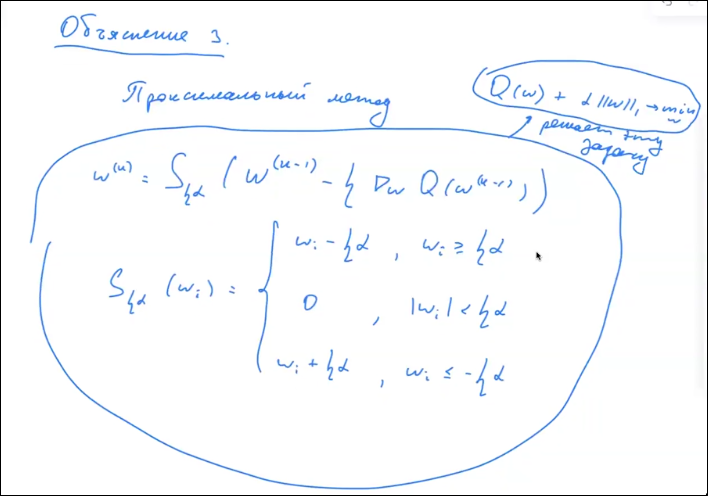


Отбор признаков  
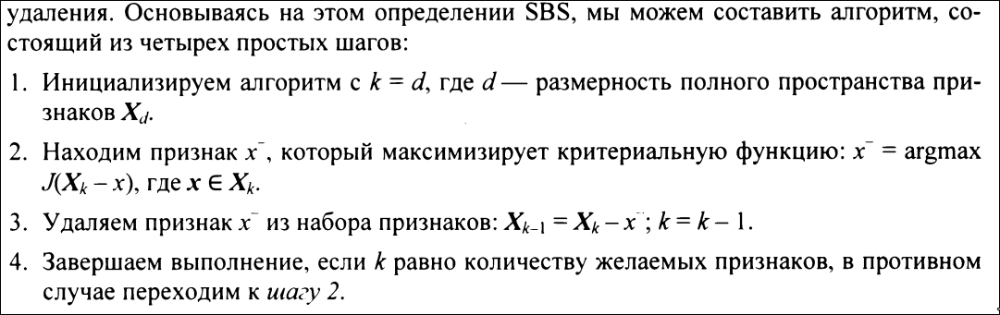

__Регрессия и LOO CV__  
* LOO - leave one out cross validation. Кросс валидация 'выкинь одного', когда мы берем всю выборку, из этой выборки один какой-то элемент отщипляем, говорим, что это тест, а на остальном обучаем и так далее.  
* При оптимизации MSE можно учить не n моделей, а достаточно обучить только одну  
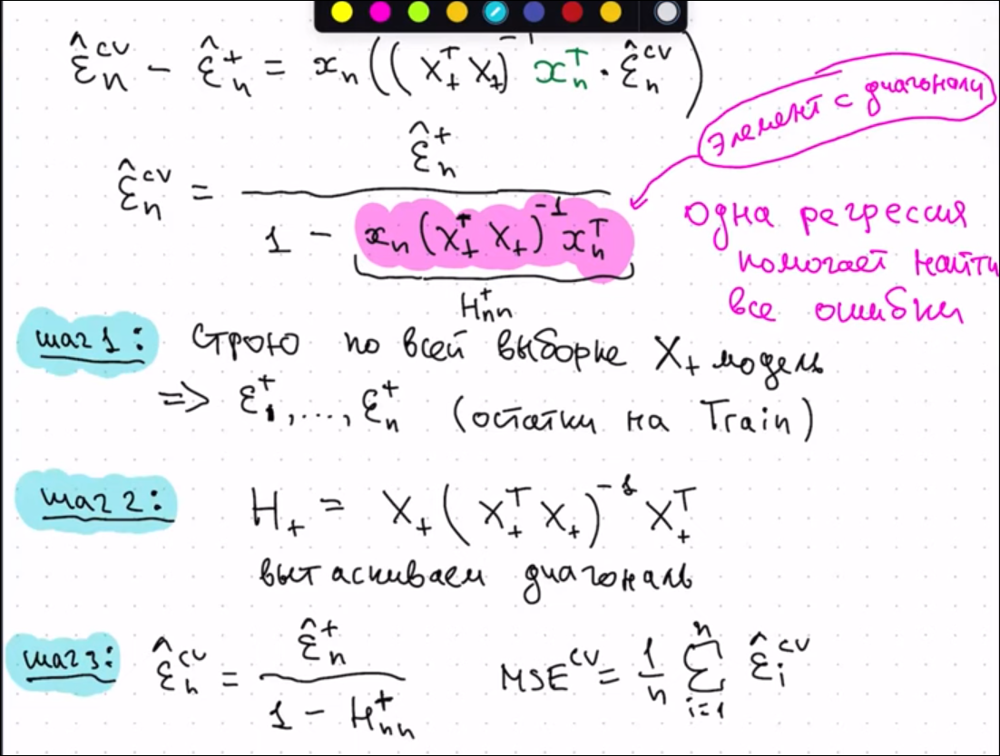

# Линейная классификация

__Бинарная классификация__  
$\mathbb{Y} = {-1, +1}$  
$a(x) = sign<w, x> $. Может выдавать 0, что делать:  
1. Сделать вид, что такого не бывает
2. Не даем ответ
3. Выдаем случайный класс
4. Выбираем выбранный заранее класс  
$a(x) = sigh(<w, x> - t), t \text{ порог }\in R$  

геометрия:  
    $<w, x> = 0$ -  ур-е гиперплоскости, w-вектор нормали  
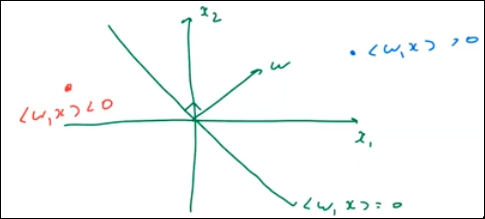  
    ну то есть лин. классификатор отделяет один класс от другого гиперплоскостью
    $|<w, x>|$ тем больше, чем дальше x от гиперплоскости. это говорит об уверенности модели

__Функционал__  
$Q(a) = \frac{1}{\ell} \sum{(a(x_i) \neq y_i)}$ - доля ошибок error rate.  $\frac{1}{\ell} \sum{(sign<w, x_i> \neq y_i)} \to \min_w$. Получается говно, которое сложно дифференцировать.  
$=\frac{1}{\ell} \sum{(y_i <w, x_i> < 0)}$. $y_i <w, x_i>$ - отступ. $sign(M_i)$ - корректоность классификации, а $|M_i|$ говорит об уверенности. $L(M)= [M<0]$ - пороговая функция потерь  
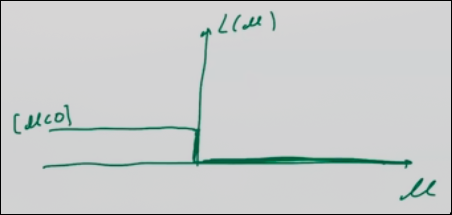  
`Идея`:$ [M<0] \leq \bar{L}(M)$ - дифф. верхняя оценка.  
$\frac{1}{\ell} \sum{[y_i <w, x_i> < 0]} \leq \frac{1}{\ell} \sum \bar{L}(y_i <w, x_i> < 0) \to \min_w$.    
* $\bar {L}_1 (M) = \log(1+ exp(-M))$ - логарифмическая функция потерь. logloss 
* $\bar {L}_2(M) = max (0, 1 - M)$ -hingeloss. SVM -  докинуть l2
* $\bar L_3 (M) = e^{-M}$
* $\bar L_4 = \frac{1}{1 + e^M}$
* $\bar L_5 (M) = \frac{\arctg(-M)}{\pi} + 1$  
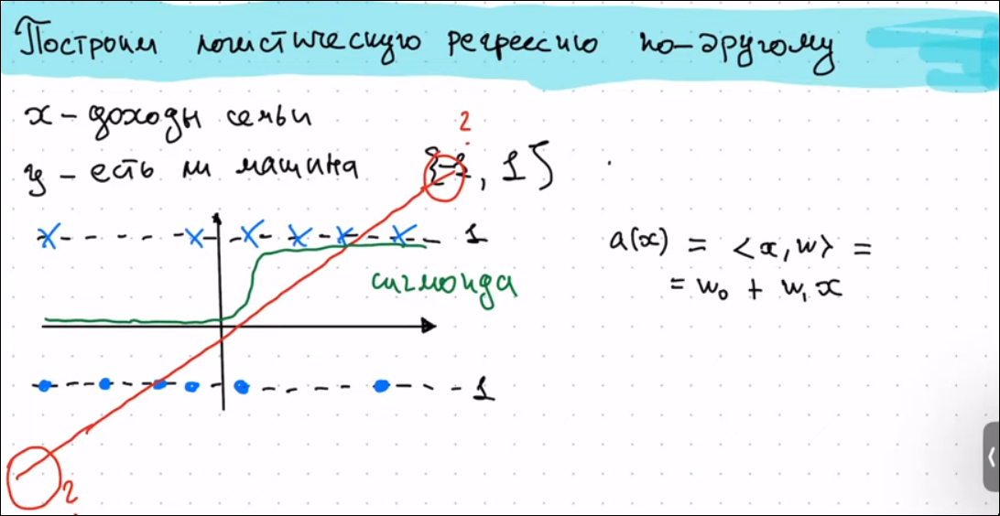  
надо подобрать какую-то кривую.  
1. Похожа на функцию распределения. Берем функцию логистического распределения.  $$\sigma (t) = \frac{1}{1 + e^{-t}}$$
$y\in {-1, +1}$. Можно интерпретировать как вероятность. $y \in {(0, 1)}$, $logloss = y_i * ln(P(x_i)) + (1-y_i) ln(1 - P(x_i))$ 

__Что прогнозируем?__  
1. MSE. $\bar p(x) = p(x)$
2. MAE.  
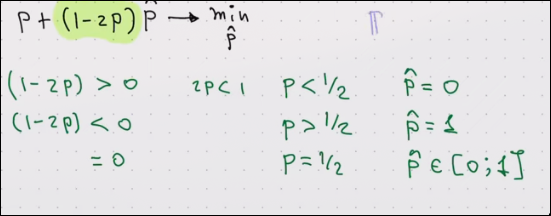  

3. $L(y, a(x)) = y * \ln(\hat p(x)) + (1 - y) * \ln(1 - \hat p(x))$
4. $L(y, a(x)) = y * \hat p(x) + (1 - y) * (1 - \hat p(x))$  


__Метрики качества классификации__  
1. `Доля верных ответов`.   
$\frac{1}{\ell}\sum{[a(x_i) = y_i]}$. `accuracy`. Может вводить в заблужение из-за дисбаланса классов. Допустим у нас +1: 50; -1:950; и мы всегда выбираем -1. Точность 95%. Мораль: вместе с accuracy надо смотреть на баланс классов. Error Rate = $\frac{1}{n} \sum{[a(x_i) \neq y_i]}$

- Отступление. Когда мы улучшаем модель есть 2 способа измерения прироста: абсолютный и относительный
2. `Матрица ошибок`.  

|   |  $y = +1$ | $y=-1$  |
| :---  | :----:   | :----:  |
| $a(x) = +1$  |  TP |  FP  |
|  $a(x) = -1$ |  FN |  TN  | 
 
* `accuracy` = $\frac{TP + TN}{TP + TN +FP + FN}$.  
$logloss \geq 1 - accuracy$
* `precision (точность)` = $\frac{TP}{TP + FP}$. Показатель того, насколько я могу доверять модели, когда она показала положительный класс. Можем максимизировать так: выбрать одного, где вот уж точно будет положительный, а всем отрицательный класс
* `recall (полнота)` = $\frac{TP}{TP + FN}$. Насколько модель покрывает положительный класс.  
__Как балансировать между плоскостью и полнотой?__
Все классификации выглядят как: $a(x) = sign(b(x)), b(x) - \text{ уверенность модели в том, что x положительный }$. Все объекты отсортируем по b(x):  
$<w, x> \\  
100  \\
99 \\
\vdots \\
-50 \\
-75
$  
Надо как-то поставить засечку, порог. Обычно точность и полноту регулируют выбором порога. $a(x) = sign(b(x) - t)$. Если я хочу увеличить precision, то порог увеличиваем, если recall, то понимаю. Обычно задают границу для одного, чтобы оно было не меньше какого-то значения, а затем максимизируют другое. Но хотелось бы объединить это.  
3. 1. Среднее арифм.  
    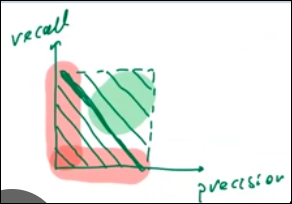
   2. M = $\min{\{precision, recall\}}$  
   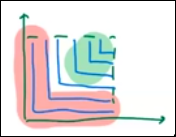
   3. Среднее гармоническое (F-мера)  
   $F = \frac{2*pr*rec}{pr + rec}$  
   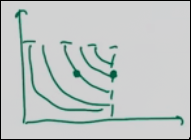  
   Есть еще $F_\alpha = \frac{(1+\alpha^2)*pr*rec}{\alpha^2 * pr + rec}$  
   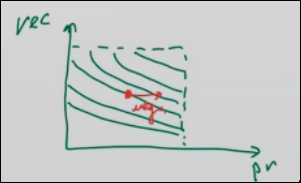
   4. Среднее геометрическое. $G = \sqrt{pr, rec}$, близко с ср.ар.
- Отступление: lift = $\frac{pr}{(TP + FN)/\ell}$. Доля небесполезных звонков, если использовать модель поделить на долю небесполезных звонков, если размечать случайно. Если lift = 1, то модель~рандом если <1, то такое себе  



__Примеры из handbook__

Конечно, даже в каждом из этих довольно частных случаев могут быть разные ситуации и разные метрики, но вот как, например, можно было бы ответить:

* `Обычный год в обычном терапевтическом отделении обычной больницы — тогда главного врача вполне устроит, если доля правильно поставленных диагнозов будет высокой (эта метрика называется accuracy).`

* `Определение очень неприятной болезни, которая жутким клеймом падёт на каждого, кому поставили такой диагноз, — тогда нам важно максимизировать долю действительно больных среди тех, кому мы имели несчастье поставить этот диагноз (эта метрика называется точностью, или precision).`

* `Определение опасной и очень заразной болезни — тогда нам важно не пропустить ни одного заражённого, и метрика будет иметь вид доли правильно определённых носителей (эта метрика называется полнотой, или recall).`



__Метрики качества ранжирования__    
https://loginom.ru/blog/classification-quality  

| l(x)  | y  | y  |
| :--- | :----: | ---:|
100 | +1 | +1 
93 | +1 | -1
$\vdots$ 
-90 | -1 | +1
  

Как измерить качество b(x) до выбора порога. 
1. ROC-кривые.  
$FPR = \frac{FP}{FP+TN} = \frac{FP}{l_{-}}$ - ошибка первого рода 
$TPR = \frac{TP}{TP+FN} = \frac{TP}{l_{+}} = recall = 1 - FNR = 1 -  \frac{FN}{FN + TP} = 1 - \beta\;\;(\text{ошибка второго рода})$ 
перебираем все t, рисуем соотв. TPR и FPR  на графике.  
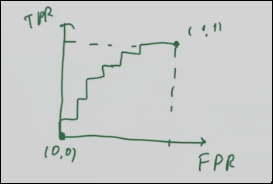  
Если у нас 'самая плохая' модель, то она самая идеальная, просто выбираем обратный класс. Всегда понятно хорошая у нас модель или нет, вне зависимоти от баланса классов и тп.
Показывает сколько у нас хороших (p(y = +1) > p(y = -1)) пар, среди плохих.  
Построение: если 1, то вверх, если 0 то вправо. И так для каждого порога
2. Precision-recall: PR-кривая.  
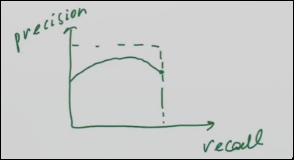  
3. Индекс Джини. Gini = 2 * (AUC-ROC) - 1
4. AUC-ROC может вводить в заблуждение, если в выборке много легких примеров. 

__Функции потерь в классификации__  
$\frac{1}{\ell} \sum{[sign<w, x_i> \neq y_i] \leq \frac{1}{\ell} \sum{L(y_i<w, x_i>)}}\to \min$. В зависимости от каждой оценки сверху, мы будем получать дополнительные свойства модели.
* $\bar {L}_1 (M) = \log(1+ exp(-M))$ - `логарифмическая функция` потерь. logloss  
Особенность: модель оценивает вероятности.
1. Хотим оценивать вероятность классов.$a(x) = +1$ с вероятность 80%. Интепретация: если мы возьмем все объекты с вероятностью p, то из них примерно 80% будут иметь положительный класс.
2. Зачем это нужно?
    2. 1. b(x) - вероятность, что клиент уйдет. Звоним, если b(x) >= 0.9. Среди них нет более 10% тех, тко не уйдет. Получается, что порог можно выбирать осмысленно.
    2. 2. Банерная реклама. Показываем юзеру один из 3х банеров. Оцениваем вероятность клика для каждого. Но клики стоят по разному, потому вероятность роляет.
3. Формализация.  
b(x) - выдает вер-ть положительного класса. $b(x) = \sigma{(<w, x>)} \in (0, 1)$. $\sigma(z) = \frac{1}{1 + \exp(-z)}$. b(x) корректно оценивает вероятности классов, если для какой-то вероятности p среди всех объектов  $x\in \mathbb{X}$ доля положительных равна p. Пусть выбрка состоит из одинаковых (с т.з. признаков) объектов. Модель обязана выбавать одно число для них. Логично, что b(x) = $\frac{1}{n}\sum{[y_i = +1]}$. $argmin, (b\in R) \frac{1}{\ell}\sum{L(y_i, b)}=\frac{1}{n}\sum{[y_i = +1]}$ - это требование к функции потерь. Тогда функция требует корректного оценивания вероятности.  
$\frac{1}{\ell}\sum{L(y_i, b)} = \frac{1}{n} \sum{[y_i = +1] L(+1, b) } + \frac{1}{n} \sum{[y_i = -1] L(-1, b)}  = L(+1, b)* \frac{1}{n}\sum{[y_i = +1]} + L(-1, b)*\frac{1}{n}\sum{[y_i = -1]}$  
$=argmin( E_y (L(y, b ) | x) = p(y=+1 | x)) = p(y = +1 | x)$  
* `Почему это работает?`. Чтобы модели не переобучались, мы сильно ограничиваем их сложность, а значит, если x1 и x2 близки, то выходы модели тоже будут близки.
* Для каких функций это работает?
- MSE: $L(y, z) = (y - z)^2$  
$L(y, z) = (b - [y = +1])^2$. $E_y(b - [y = +1])^2 = (b - 1)^2 * p(y = +1 | x) + b^2 * (1 - p)$. $b* = p(y=+1 | x)$, то есть MSE будет корректно оценивать вероятсноти.  Но это так себе идея...  
$\frac{1}{\ell} \sum{(\sigma(<w, x_i>) - [y_i =+1])^2}$  
$\nabla_w (\sigma(<w,x>) - [y_i = +1])^2 = 2 (\dots) \sigma'(<w, x_i>)$. При малых значениях почти 0. Из-за этого градиент может встать нах. Потому квадрат забраковываем.  
* $L(y, b) = |b - [y_i = +1]|$. Требование с вероятностью не выполняется, так как выдает только 0 или 1.
* Предположим, что для любого объекта x его класс y имеет распределение Бернулли с вер p(y = +1 | x). Надо предположить, как p связана с объектом:  
$p(y = +1 | x)= \sigma(<w, x>) = b(x)$. Запишем правдоподобие:  
$$\prod{b(x_i)^{[y_i= +1]} * (1 - b(x_i))^{[y_i = -1]}}\to \max_w$$  
Логарифмируем с минусом. $$\sum{-[y_1 = +1] * \log{b(x_i)} - [y_i = -1] * \log{(1 - b(x_i))}}$$  
logloss, бинарная кросс энтропия. САМАЯ популярная функция потерь. Условие про вероятность выполнено.  
$$\frac{1}{\ell} \sum{-[y_i = +1] \log{\frac{1}{1 + \exp^{-<w,x>}}} - [y_i = -1]\log(1 - \frac{1}{1 + \exp^{-<w,x>}})}$$  
$$=\frac{1}{\ell} \sum{( \log{(1 +  \exp^{-y_i*<w,x>})})}$$  
$$=\frac{1}{\ell} \sum{( \log{(1 +  \exp^{-M})})}$$ 
Логистическая функция потерь. Что еще бывает: $b(x)=Ф(<w, x>), Ф \sim N(0, 1)$ - probit регрессия

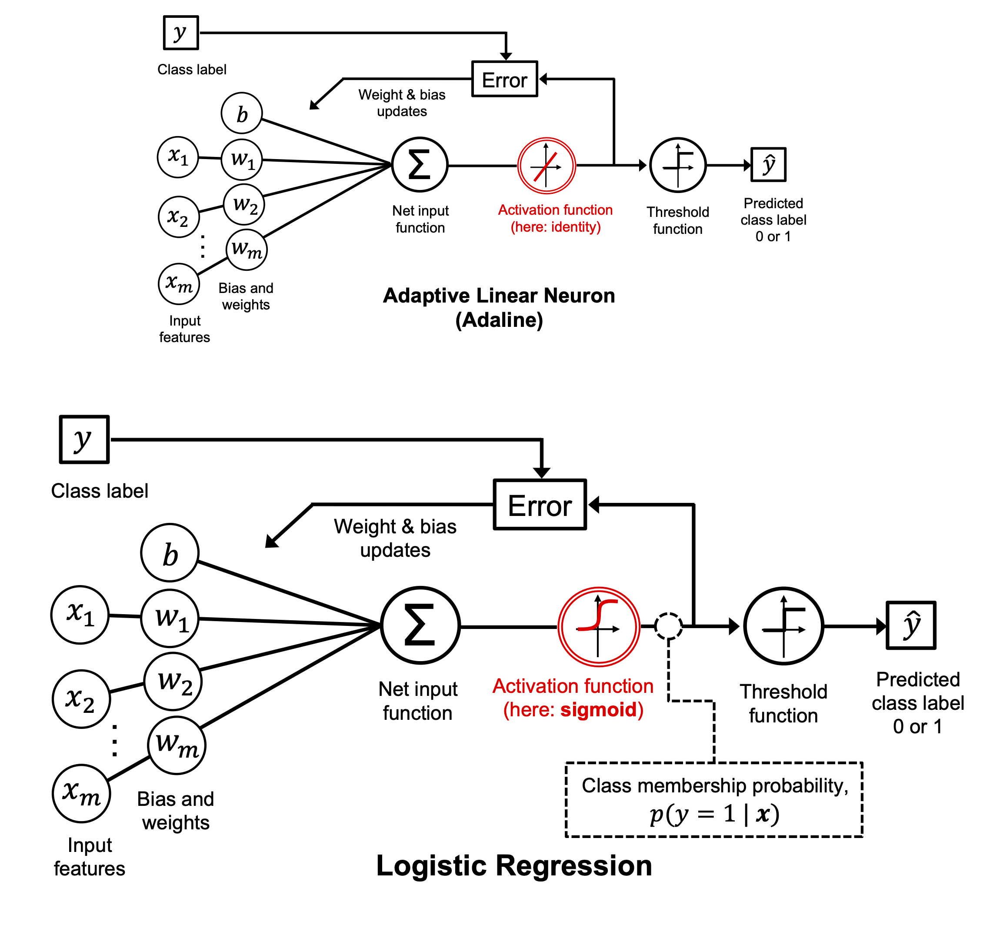

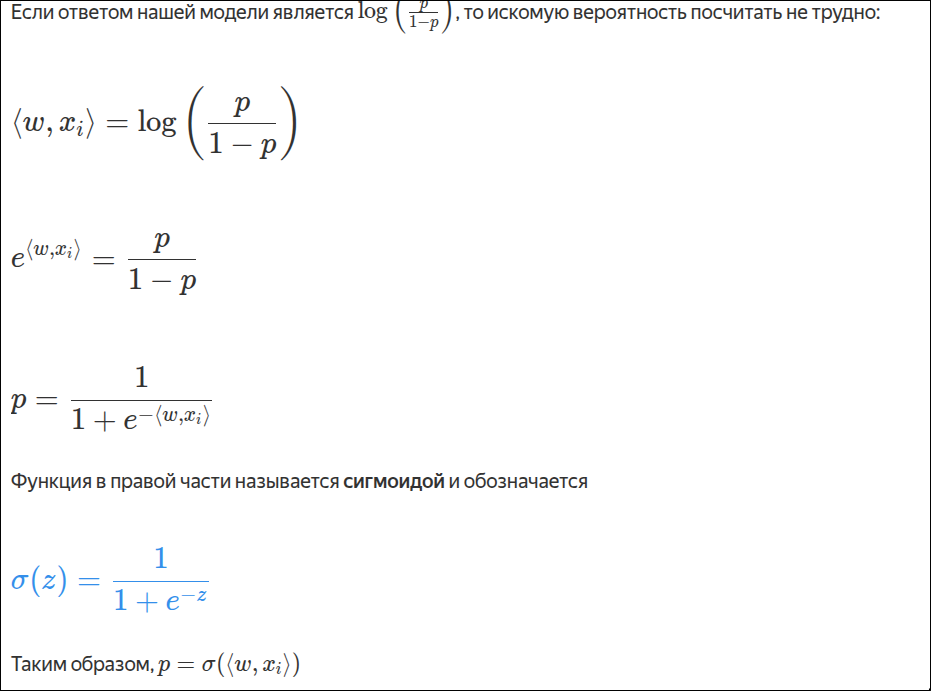

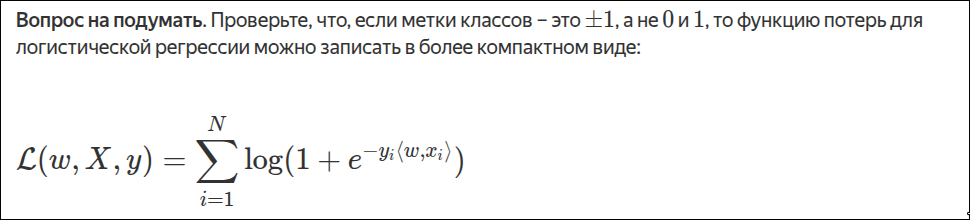

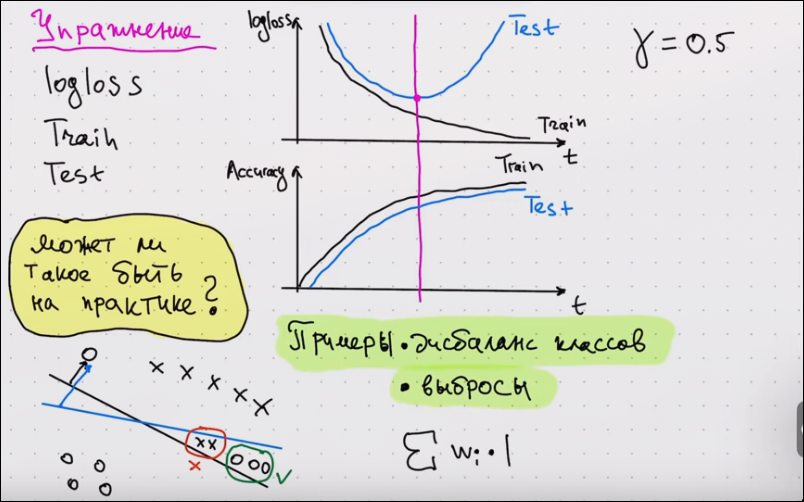  
Есть вот такая задачка с собесов. $\sum {w_i * loss}, w_i \text{ -  доля класса}$  


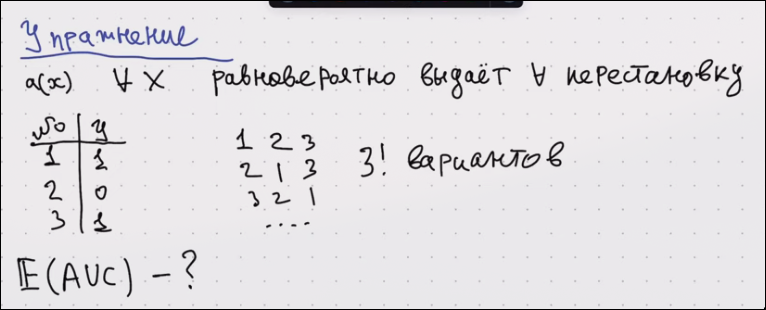  
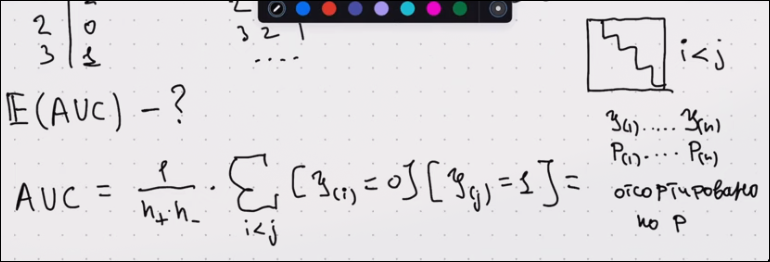  
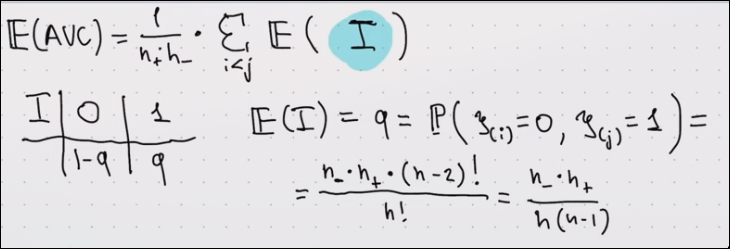  
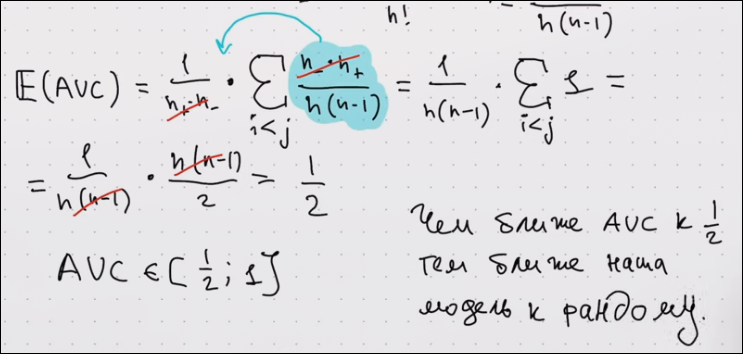

# Мат.дифференцирование  
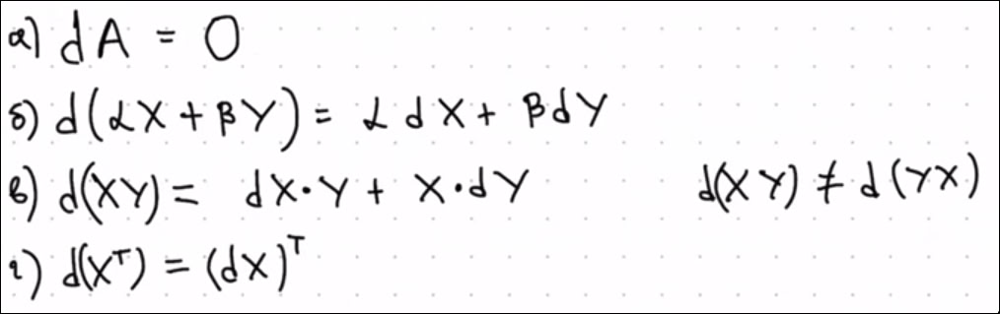  
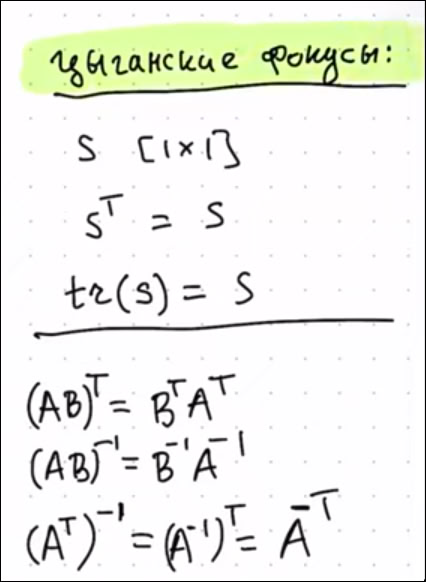  
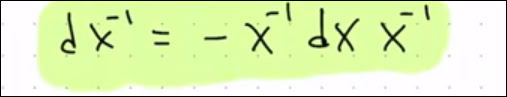  
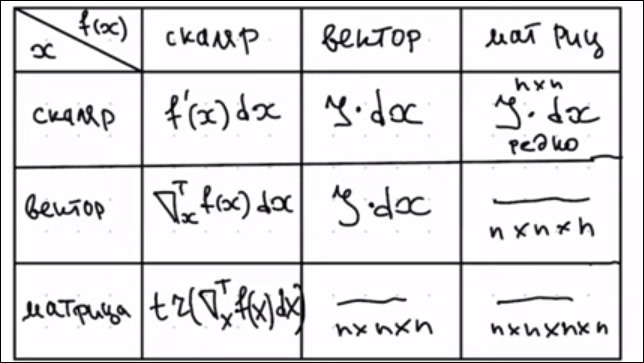  
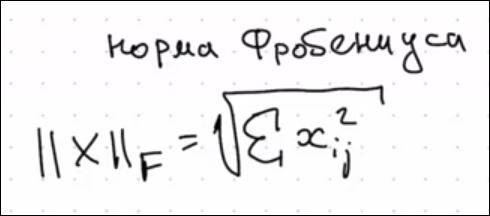

__Бокс-Кокс__  
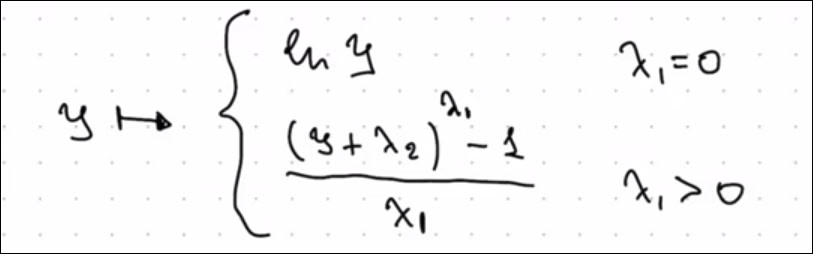

#  Метод опорных векторов  (SVM)
$\bar L = \max(0, 1 - M)$  
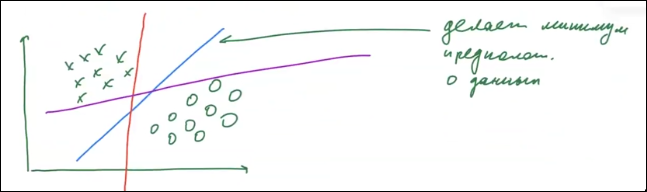  


__Линейно разделимый случай__  
$\exist w \in R^d: \;\;\; y_i (w, x_i) > \ 0$  
$a(x) = sign((w, x) +w_0)= sign(\alpha(w, x)+ \alpha w_0), \;\;\; \alpha > 0$  
$\min{|((w, x_i) + w_0)|} = 1$ - *, можно добиться масштабированием параметров. Считаем, что оно выполняется.  
$\rho (x, \alpha) = \frac{|(w, x) + w_0|}{||w||}$  
$\min{(\rho (x_i, a))} = \min{\frac{|(w, x) + w_0|}{||w||}} = \frac{1}{||w||} \min{|(w, x_i) + w_0|} = \frac{1}{||w||} \;\;\; (*)$  
Если я хочу модель, у которой максимальное расстояние до ближайшего объе кта, то $\frac{1}{||w||} \to \max_{(w, w_0)} \to ||w|| = 0)))$. Надо как то исправить. $$ y_i ((w, x_i) + w_0) \geq 1 + (||w||^2 \to \min)$$ - задача  SVM

__Линейно неразд. случай__  
$\forall w, w_0 \exist x_i \in \mathbb{X}: y_i ((w, x_i) + w_0) < 0$  
Пусть выполняется:    
$||w||^2 + C \sum{\epsilon_i}\to \min$  
$y_i ((w, x_i) + w_0) \geq 1 - \epsilon_i$  
$\epsilon \geq 0$  
(\*\*)  
SVM для общего случая  
$||w||^2$ -  штраф за маленькое расстояние до ближайшего объекта, за сложноть модели. $\epsilon_i$ - штраф за ошибки модели. С - гиперпараметр, который отвечает за баланс. По $\epsilon_i$ берем L1, а не L2 норму. Надо, чтобы $\vec{\epsilon}$. Т.е чтобы много объектов было подальше от разделяющей гиперплоскости.  
(**) попробуем упростить 2 звездочки:  
$\epsilon \geq 1 - y_i ((w, x_i) + w_0)$  
$\epsilon \geq 0, \epsilon \to \epsilon = \max(0, 1 - y_i ((w, x_i) + w_0))$  
$||w||^2 + C \sum{\max(0, 1 - y_i ((w, x_i) + w_0))}$, то есть получили регуляризатор + ошибку

__LR vs SVM__  
При M < 0  поведение одинаково, a M > 0: SVM достаточно M>=1, LR хочет, чтобы $m -> \infty$. LR стремится корректно оценивать вероятность. SVM не тратит силы на ерунду и дает более высокие значения метрик качества классификации (AUC-ROC, f мера).

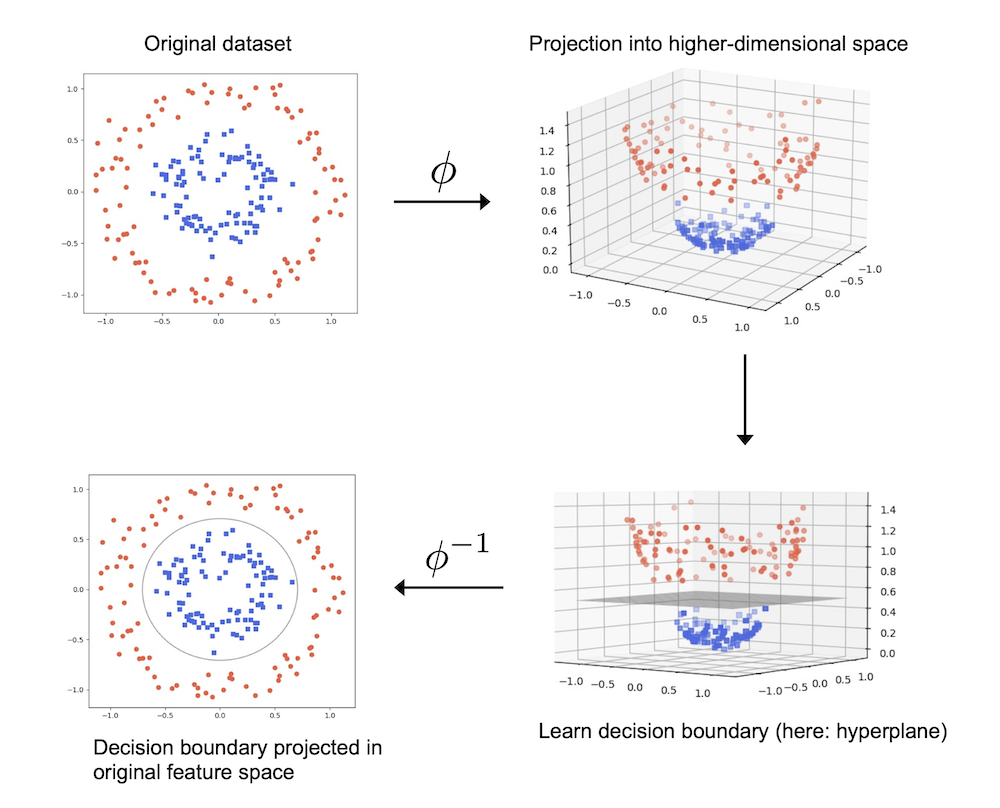

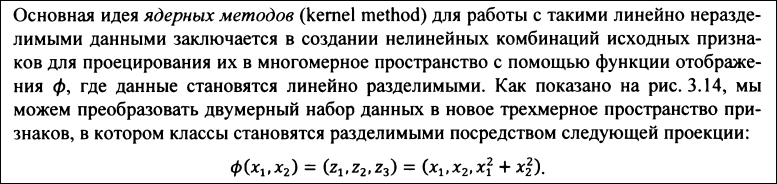

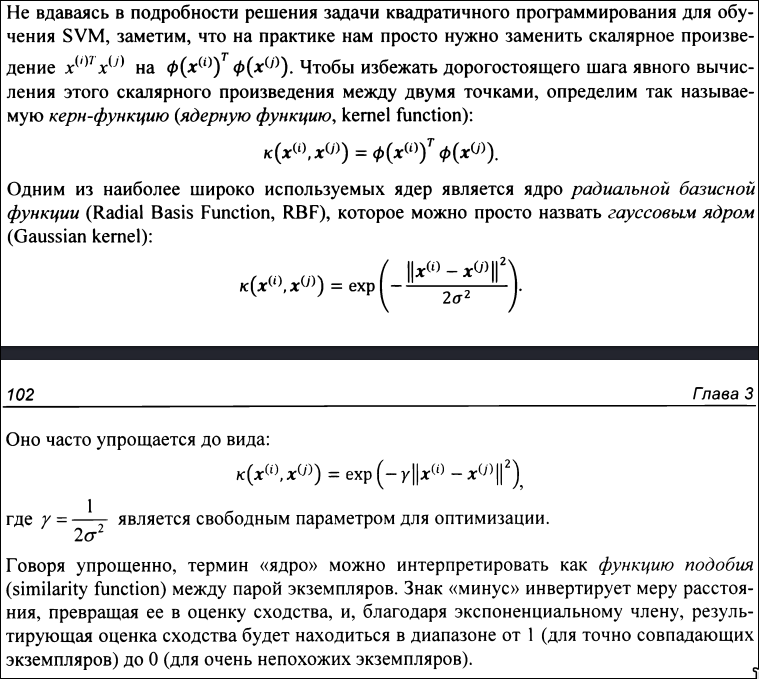

# Многоклассовая классификация (multiclass classification)  
* ${1, \dots k}$. Сводим эту задачу к серии бинарных задач  
1. Один против всех (one vs all OVA, one vs vest OVR)  
для каждого класса я строю свою модель $b_k (x) = <w_k, x> + w_{0k}$. Обучаем на $\mathbb{X_k} = (x_i, [y_i = k])^\ell$. $a(x) = argmax\;\;\;b_k(x)$. (+) это легко. (-) - много параметров; $b_k (x)$ не знают друг о друге при обучении.
2. Все против всех (all vs all, AVA). Турнир между всеми парами классов  
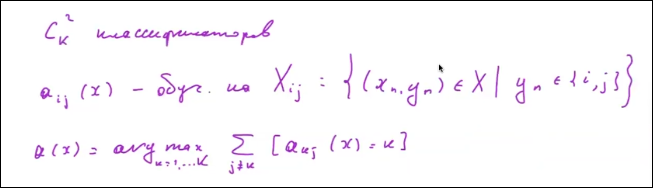  
(+) нет проблем с некалиброванностью моделей  
(-) $К^2$ классификаторов
* Прямые подходы  
1. многоклассовая логистическая регрессия  
$b_k(x) = (w_k, x) + w_0$  
$x \to b(x) = (b_1 (x), \dots b_k(x))$  
Soft Max (z1, ..., zk) = $(\frac{exp(z_1)}{\sum{e^{z_i}}}), \dots, \frac{exp(z_k)}{\sum{e^{z_i}}}$  
$\mathbb{P} (y = k | x) = \frac{exp(<w_k> +w_{0k})}{\sum{exp(<w_k> +w_{0j})}}$  
$\sum{\log\mathbb{P(y = y_i | x)}} \to \max$. у нас общий знаменатель у дробей и получается, что классы знают про друг друга
* Метрики качества многоклассовой классификации.
1. accuracy = $\frac{1}{\ell} \sum {[a(x_i) = y_i]}$
2. k-й класс, $TP_k$, FP_k. FN_k, TN_k$  
Микро-усред. $\bar{TP}$. precision = $\frac{\bar{TP}}{\bar{TP} + \bar{FP}}$. Большее влияние у крупных классов  
Макро-усред. $precision_k$ = $\frac{TP_k}{TP_k + FP_k}$, precision_k = $\sum{\frac{1}{k} \sum{pr_k}}$. Все классы имеют равный вклад.

__multi label__  
binary relevance. просто забиваем на то, что классы могут быть связаны и учим свой классификатор

# Решающие дереве (decision trees)  
Есть линейные модели: (+) дифференцируемы, можем обучать градиентными методами, (-) линейны.  
Будем придумывать недифф. модели  
1. Структура. Решающее дерево - бинарное дерево, где:  
- v- внутренняя вершина => $\beta_v (x) \;\;\;(предикат): \mathbb{X} \to [0, 1]$
- v- лист, то $с_v \in \mathbb{Y} $-  прогноз. Бывают  multi-way деревья, но это оч трудозатратно и есть риски переобучения.  
Предикаты бывают разные:  
$\beta_v(x) = [x_j \geq t]$ (основной)  
$\beta_v(x) = [<w, x> \geq t]$  
$\beta_v(x) = [\rho(x, x_0) \geq t]$  
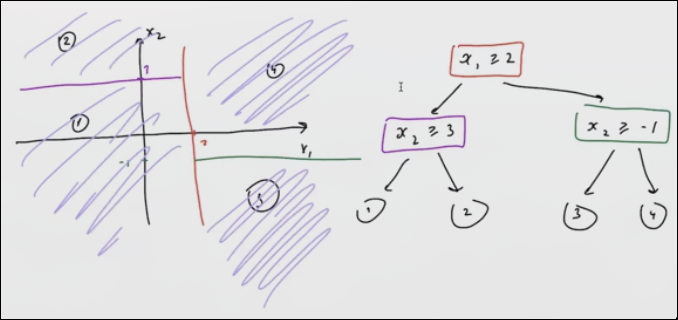  
Каждый лист соответствует одной из областей пространства. У нас есть проблема, что на одно наблюдейние может быть выделена своя область, то есть переобучение, легко переобучить.  
регрессия: $c_v \in \mathbb{R}$  
классиф: $c_v \in {1, \dots, v}$. $c_v \in R^k: c_{v_k} \geq 0, \sum{c_{v_k}} = 1$.  


__Обучение деревьев__  
* Утв. Если в обучающей выборке нет такой ситуации, что признаки равны, а ответы не равны, то гарантированно существует дерево с нулевой ошибкой.  
* Гипотеза: если из всех корретных на $\mathbb{X}$, взять самое маленькое, то такое не будет переобученным/будет хорошо обобщать. Задача NP трудная. В таком случае обходимся жадными алгоритмами решения.  
m - номер вершины, Rm - объект из X, которые попали в текущую вершину. 
начало: SplitNode(1, X).  

SplitNode(m, Rm):    
&emsp;&emsp; если выполняется `критерий останова`:  
&emsp;&emsp;&emsp;&emsp;$c_m$ =  1. Средние ответ по R_m, 2. Самый частый класс, 3. Доли классов в $R_m$.   
&emsp;&emsp;&emsp;&emsp;выход   
&emsp;&emsp;j, t = argmax $( Q(R_m, j, t) )$. Q - функционал качества предиката, критерий информативности предиката. Решает перебором.  
&emsp;&emsp;$R_{left} = {(x, y) \in R_m | [x_j \geq t] = 0}$  
&emsp;&emsp;$R_{right} = {(x, y) \in R_m | [x_j \geq t] = 1}$  
&emsp;&emsp;SplitNode(left, $R_{left}$)  
&emsp;&emsp;SplitNode(right, $R_{right}$)  

t ($\gamma$), это наш порог и на каждом шаге подбирается перебором. $t = \frac{x_i + x_{i+1}}{2}$ ну то есть это середина между порогом и следующим значением.

__Критерий останова__  
1. Максимальная глубина
2. Ограничим минимальное количество объектов в листе
3. Доля ошибок в листе  
__Критерии качества предикаторов__  
$H(R)$ - impurity. Показывает разнородность ответов в R  
регр: $H(R_m) = \frac{1}{|R_m|} \sum{(y_i - \hat y)^2}$  
классиф: $p_{mn} = \frac{1}{|R_m|} \sum{[y_i = k]}$  
&emsp;&emsp; &emsp;&emsp; H(R) = $\sum{p_{mk} * \log{p_{mk}}}$ - энтропия  
&emsp;&emsp; &emsp;&emsp; H(R) = $\sum{p_{mk} *(1 - p_{mk})} = 1 - \sum{p_{mk}^2}$ - Критерий Джини  
&emsp;&emsp; &emsp;&emsp; H(R) = $\sum{1 - max(p(i|m))}$

Энтропия:  
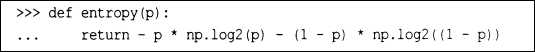

Откуда брать H(R)?  
Общий подход:  
$H(R) = \min_{c\in \mathbb{Y}}\frac{1}{|R|} \sum{L(y_i, c)} = \hat{Var}(y)$ - ошибка лучшего константного предсказаниях. Если константой можно добиться низкой ошибки, то у меня imppurity будет низкой.  
$Q(R_m, j, T) = H(R_m) - H(R_{left}) - H(R_{right}) \to \max$. Предикат тем лучше, чем сильнее он снижает хаотичность после разбиения.  
$Q(R_m, j, T) = H(R_m) - \frac{|R_{left}|}{|R_{m}|} * H(R_{left}) - \frac{|R_{right}|}{|R_m|} * H(R_{right}) \to \max$. Есть такая нормировка, чтобы не допустить отрезания по одному объекту.  
Для простоты: $\frac{|R_{left}|}{|R_{m}|}*H(R_{left}) + \frac{|R_{right}|}{|R_m|} * H(R_{right}) \to \min$  
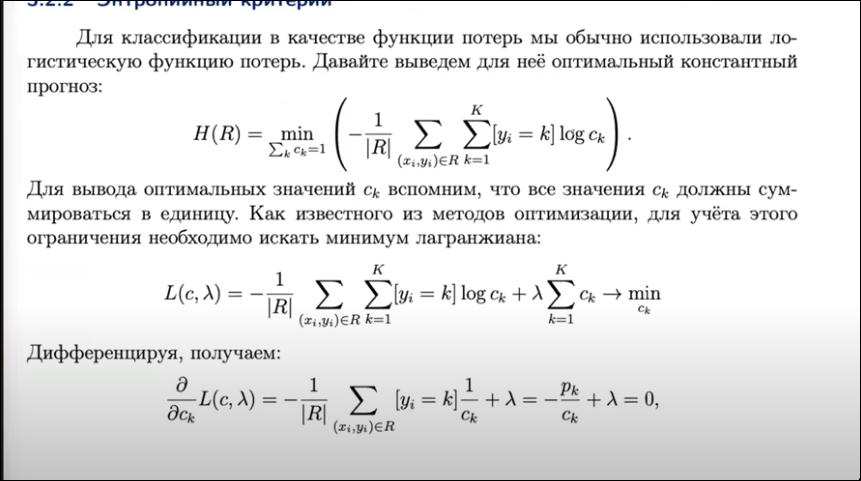  
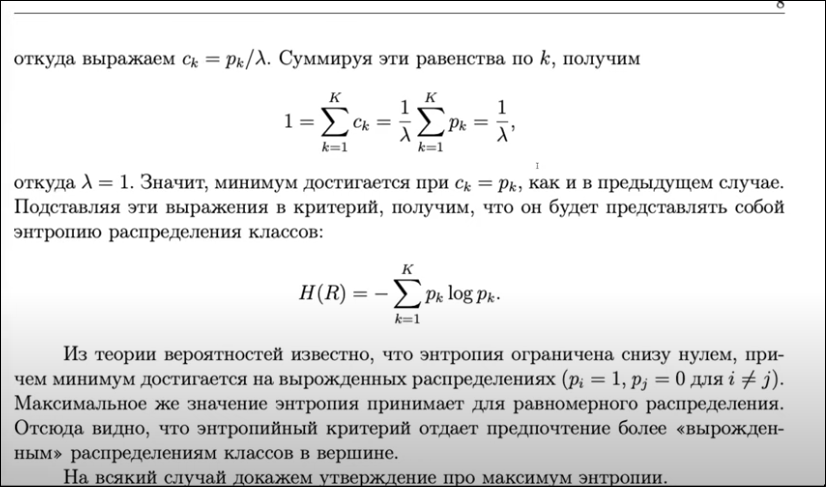

__Стрижка деревьев__  
* cost-complexity pruning

__Обработка пропусков__  
1. Обучение: в R у j-го признака есть пропуски. $[x_j \geq t]$ - как посчитать?, как оценить Q?  
Пусть $V_j(R)$ - объекты из R, у которых неизвестен x_j, тогда $Q(R, j, t) = \frac{|R\setminus V_j(R)|}{|R|}Q(R\setminus V_j(R), j, t)$  
Если выбрат предикат с j-м признаком, то мы объекты с пропусками отправляем и влево, и вправо с весами $\frac{|R_l|}{|R|}, \ \frac{|R_r|}{|R|}$ соответственно.  
Применение: $a_{mk}$ - прогноз k-го в вершине m  
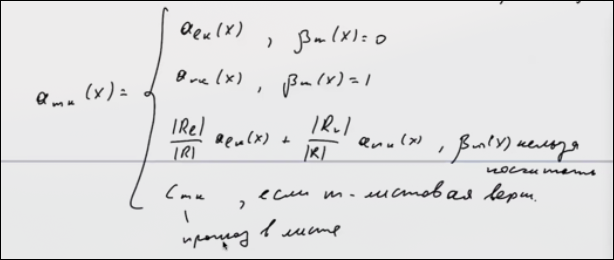  
2. Метод с суррогатными предикатами  
в каждой вершине мы выбираем лучший предикат $\beta(x)$ без учета пропусков. Ищем несколько суррогатных предикатов (которые дают похожие разбиения) $\beta ' (x)$, $\beta '' (x)$.  
Применение: $x\to\beta(x) \to \beta'(x) \to \beta''(x)$. Если не получилось, т отправляем в суррогат

__Энтропия__  
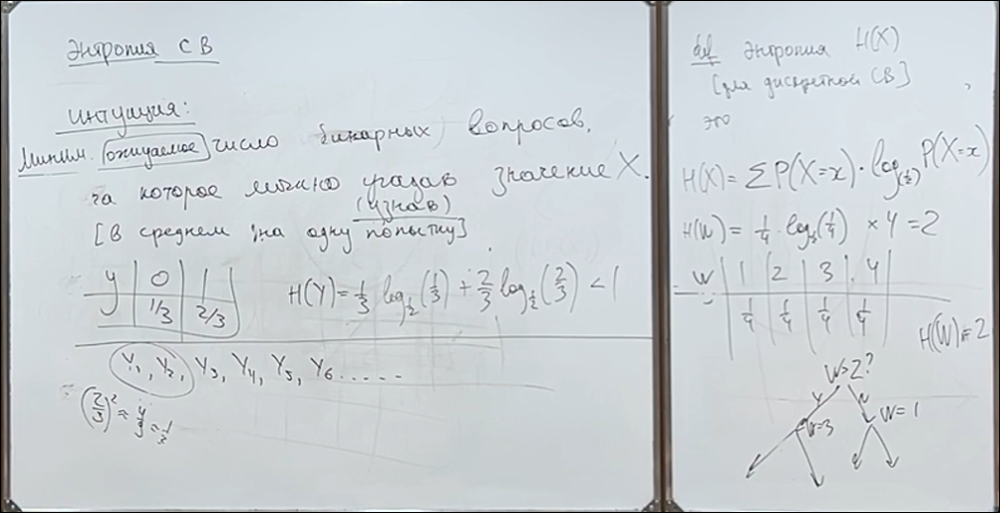  
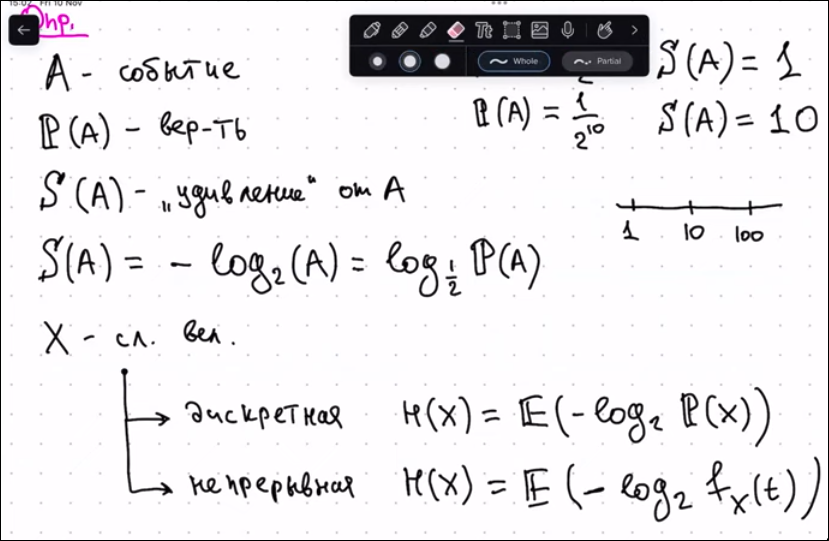  
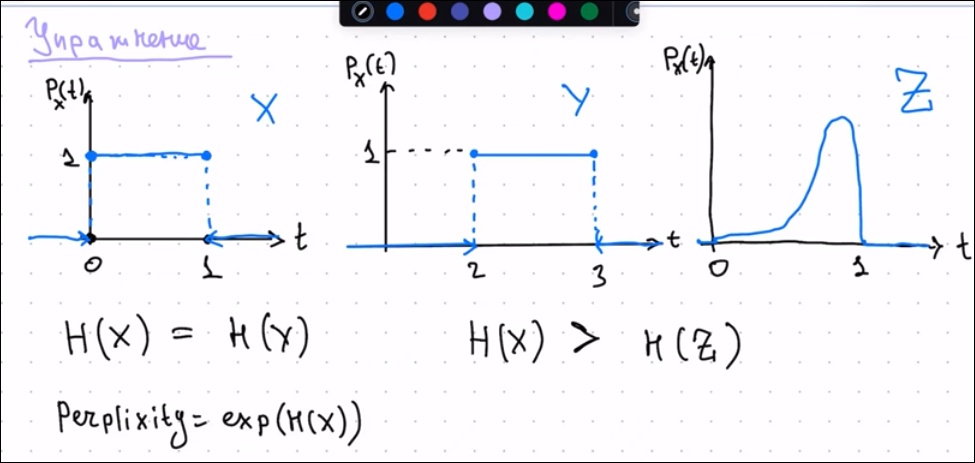  
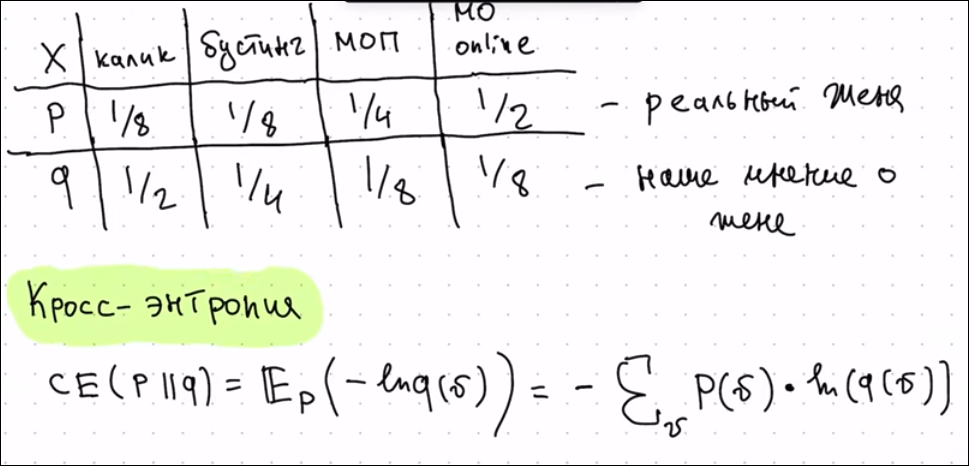  
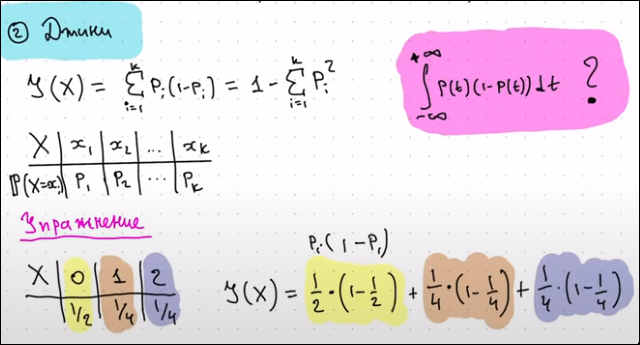  
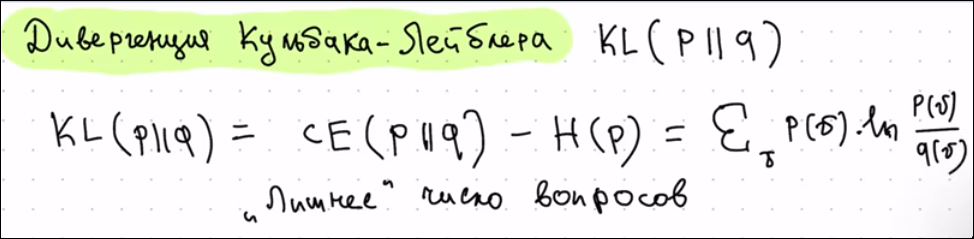 

__Работа с категориальными признаками__  
$x_j$ - категориалный признак  
$x_j \in Q =  \{u_1, \dots, u_q\}$  
* Тривиальные варианты:  
1. $\beta_m (x) = [x_j = q]$
2. multi-way splits  
* Вариант по-лучше:  
$Q = Q_1 \bigcup Q_2$  
$b_m (x) = [x_j\in Q_1]$. Как разбить на подмножества оптимально?  
$R_m(u) = \{(x, y) \in R_m | x_j = u\}$  
$N_m (u) = |R_m|$  
$\mathbb{Y} = \{-1, +1\}$  
упорядочим категории: $u_{(1)}, \dots, u_{(q)}$  
$\frac{1}{N_m (u_{(1)})}  \sum\limits_{\substack{(x_i, y_i) \in R_m(u_{(1)})}}{[y_i = +1]} \leq \dots \leq \frac{1}{N_m (u_{(q)})}  \sum\limits_{\substack{(x_i, y_i) \in R_m(u_{(q)})}}{[y_i = +1]}$  
разбиение я делаю только в таком порядке:  
$u_{(1)} | u_{(2)}| u_{(3)}|\dots| u_{(q)}$. Вместо $2^q$ вариантов получаем $q -1$ для перебора. И утверждается что среди таких разбиений существует оптимальное. 

__Методы построение__  
$ID_3$: этроп. критерий, кр. останова  
$C_{4.5}$: Gain Ratio, стрижка  
CART: ...  

__Связь деревьев и лин.моделей__  
Дерево разбивает пространство объектов $\mathbb{X}$ на N областей: $\mathbb{X}= J_1 \bigcup \dots \bigcup J_n$  
$w_1, \dots, w_n$ - прогнозы в соответствующих листьях.  
$a(x) = \sum\limits_{j = 1} ^ n {w_j[x\in J_j]}$. Индикатор: как бы признаки какие-то. w: как бы веса. И все это выглядит как линейная модель с какими-то весами. То есть дерево как бы находит новые нелинейные признаки и строит над ними лин.модель  
`Идея`:  
1. Номера листьев или индикаторы попадания в листья м.б. хорошими признаками  
2. можно построить дерево со случайными предикатами - и оно может все равно дать хорошие признаки. И так иногда делают

# Композиции (ensembles) 
* Гипотеза: хорошие модели устройчивы к небольшим изменениям в обучающей выборке  
Если я в дереве выкину 10%, то дерево оч сильно среагирует и деревья неучтойчивы... Но вообще, где реально проходят границы классов, то они справляются нормально, это на выбросы они как-то странно реагируют  
Идея: а что если усреднить прогнозы деревьев.  
$X = (x_i, y_i)^{\ell}, \mathbb{Y} = R$.  
бустрап: генерация подвыборки из X через выбор $\ell$ объектов с возвращением. 
$X\to X_1, \dots X_n$ - подвыборки  
$y(x)$ - истинный ответ  
$p(x)$ - плотность на $\mathbb{X}$  
$\epsilon_j(x) = b_j(x) - y(x)$  
$\mathbb{E}_x(b_j (x) - y(x))^2 = \mathbb{E}_x(\epsilon_j)^2 = \mathbb{E}_1$  
Предположение:  
1. $\mathbb{E} (\epsilon_j (x)) = 0$ - несмещенность  
2. $\mathbb{E} (\epsilon_j (x) * \epsilon_j (x), i\neq j)=0$, это сильное предположение, что ковариация нулевая, посколько модели обучаем на пересекающихся выборках.  
$$a_N(x) =\frac{1}{N} \sum{b_j(x)}$$  

$\mathbb{E}_x (\frac{1}{N} \sum{b_j(x) - y(x)})^2$  

$=\mathbb{E}_x (\frac{1}{N} \sum{b_j(x)} - \frac{1}{N} \sum{y(x)})^2 = \mathbb{E}(\frac{1}{N} \sum{b_j(x)})$  

$=\mathbb{E}_x (\frac{1}{N} \sum{\epsilon_j(x)}) = \frac{1}{N^2}\mathbb{E}_x ( \sum{\epsilon_j^2(x)} + \sum\limits_{i \neq j}{\epsilon_j * \epsilon_i(x)})$  
$=\frac{1}{N^2} \sum{\mathbb{E}_x \epsilon^2 (x)} = \frac{1}{N^2} * E_1 * N = \frac{1}{N} * E_1$.  
ПОЛУЧАЕТСЯ ЧТО ОШИБКА КОМПОЗИЦИИ МЕНЬШЕ ОШИБКИ ОДНОЙ МОДЕЛИ В N РАЗ!!!  
Но, вообще, предпосылки слишком сильные... Нам хотелось бы понять как в реальности это сделать:

__Bias-variance decomposition (BVD)__  
не то чтобы какой-то реально прикладной инструмент, но удобный язык для описания  
$p(x, y) \in X \times Y$  
$L(y, a) = (y-a)^2$  
Как вообще складывается ошибка?  
Среднеквадратичный риск:  
$R(a) = \mathbb{E}_{x, y} (a(x) - y)^2 = \iint\limits_{X\ Y} {(a(x) - y)^2 *p(x, y)\ dx \ dx}$  
Можно показать: можно найти оптимальные $a_{(*)} = \mathbb{E}(y | x) = \int\limits_{Y} {y *p(y | x) dy}$  
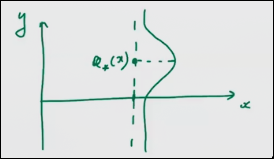  


__Метод обучения__  
$\mu: (X \times Y)^{\ell}$ (пространство обучающей выборки) $\to A$ (семейство моделей). Пример: $\mu (x) =argmin \ \frac{1}{\ell} \sum{(a(x) - y)^2} + 2 ||w||^2$ + метод оптимизации.  
$L(\mu) = \mathbb{E}_x \mathbb{E}_{x,y} (\mu(X)_{(x)} - y)^2$.  $\mu(X)_{(x)}$ - модель, ее прогноз на тестовом объекте х.  То есть я получил ошибку, усредняю на всем пространстве объектов и дальше еще усредняю по всем обучающим выборкам. То есть ошибка метода обучения показывает насколько хорошие получаются модели в среднем по всем обучающим выборкам.  
$L(\mu)$ =  
1. $+\mathbb{E}_{x, y} (y - \mathbb{E} (y|x))^2$.   
$\mathbb{E} (y|x)$ - (лучшая модель, то есть в данном слагаемом записана ошибка лучшей модели и называется это шумом. Нижняя граница на ошибку модели, лучше не будет).  
2. $+ \mathbb{E}_x (\mathbb{\mu(x)} - \mathbb{E}(y | x))^2$ (в скобочка: (средняя модель - лучшая модель)) (смещение (bias) - отклонение средней модели от лучшей, характеристика того насколько моя модель похожа на лучшую)  
3. $+ \mathbb{E}_x \mathbb{E}_x (\mu(X) - \mathbb{E}_x \mu(X))^2$  
$\mu(X)$ - конкретная модель, обученная на выборке X, $\mathbb{E}_x \mu(X)$ - средняя модель. Это показатель того, насколько у меня модель у меня может поменяться от изменения выборки. Разброс, variance -  показатель неустойчивости  
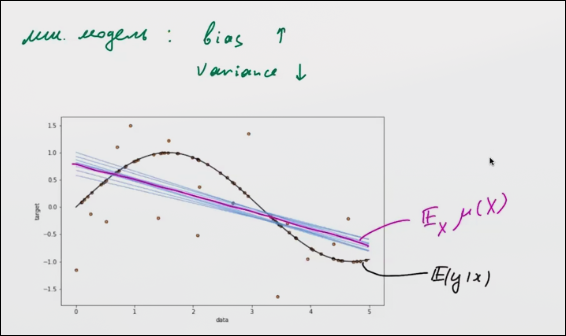  
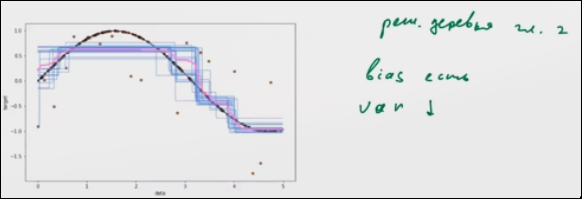  
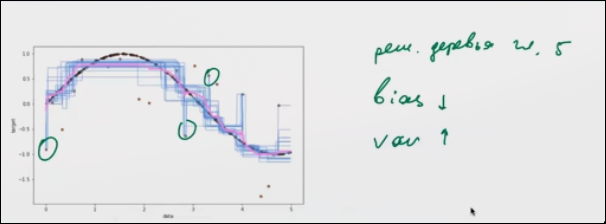  
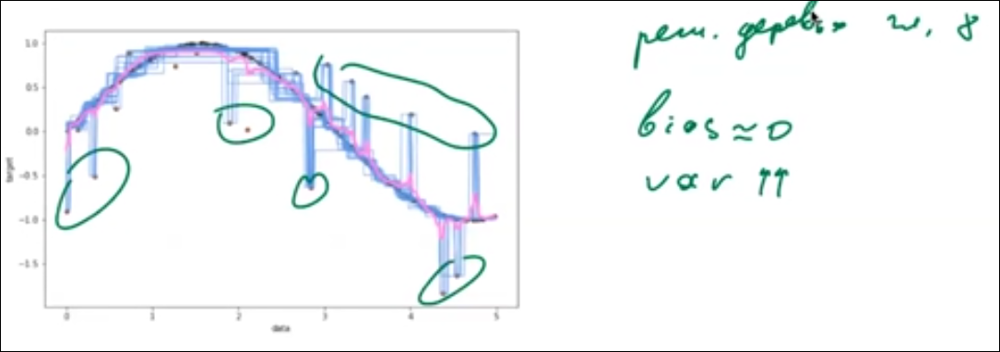  
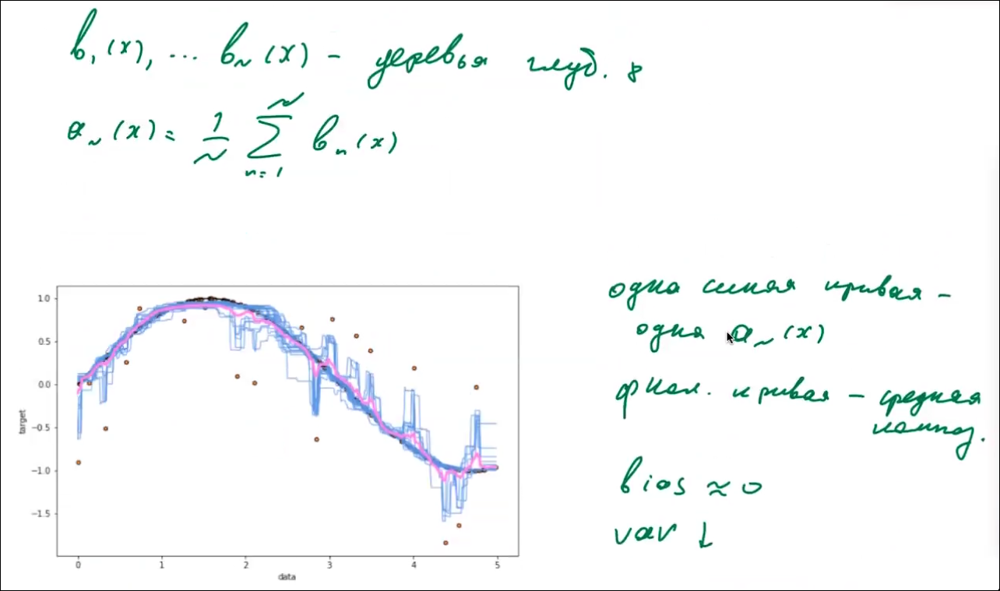

__Ensembles = Лес__  
У деревьев малый bias, но высокий var. $b_i(x) \to a(x)$. Я хочу из нескольких моделей получить одну (ансамбль).  
$a(x_i) = \frac{1}{N} \sum{b_j(x_i)}$ работает более классно.  
$\mathbb{E}(a(x_i)) = \frac{1}{n} \sum{\mathbb{E}(b_j(x_i))} = \mathbb{E}(x_i)$. То есть смещение не изменилось.  
$Var(a(x_i)) = \frac{1}{N^2} \sum{Var(b_j(x))} = \frac{Var(b_j(x))}{N}$, а вот разброс упал, ну при условии что корреляция нулевая.  
Техники:  
1. бутстрап  
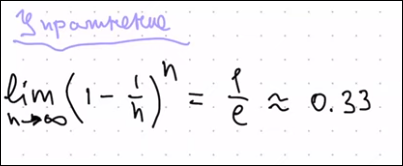  
out of back sample (oob sample). Можно проверить на этих наблюдениях, не попавших в выборку, тест и проверить качество ансамбля
2. Рандомные фичи, будем брать какое-то подмножество фичей  
Объединение - случайный лес

__Разложение на смещение и разброс__  
Случайности  
$X = (x, y)_{i=1}^n $  
$\epsilon $ - шум
$E_{X, \epsilon} [y(x, \epsilon) - a(x, X)]^2$ = $\sigma ^2 \text{ (шум)} + Var_x (a(x, X)) + bias_x ^2 (a(x, X))$.  
$y(x, \epsilon) = f(x) + \epsilon$.  
$[f(x) - E_{X} (a(x, X))]$ - bias.  
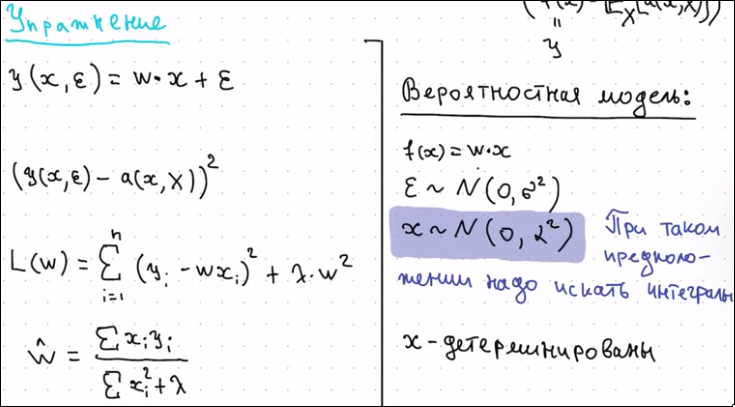  
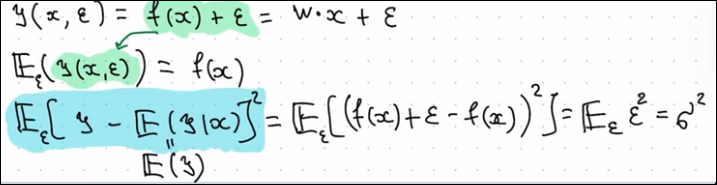  
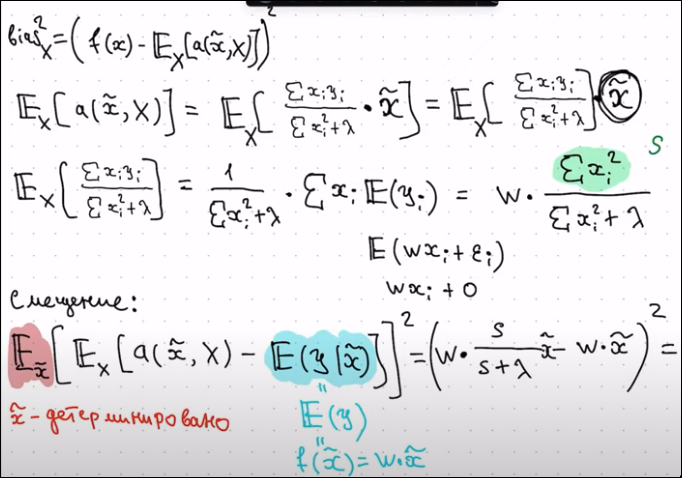  
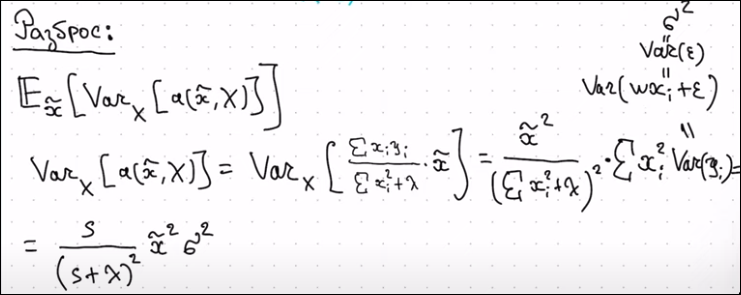  
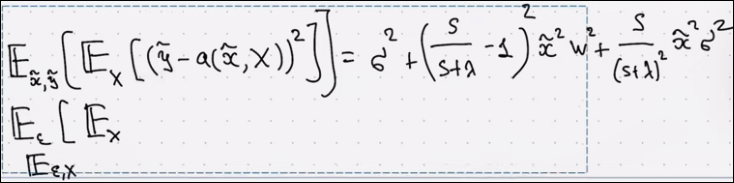  
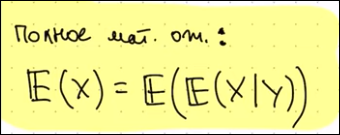

__Беггинг (bagging)__  
Идея метода:  
$\mu(X)$ - метод обучения  
$\tilde{X}$ - случайная подвыборка Х, сгенерированная бутстрапом. 2/3 уникальных элементов. У каждого элемента появлется вес, равный его количеству в бутстрапированной выборке.  
X: $\tilde{X_1}, \dots, \tilde{X_n}$.  
$X_i \to b_i (x) = \mu(\tilde{X_i})$. $b_i$ называют слабыми моделями.  
Композиция (беггинг): $a_n (x)= \frac{1}{n} \sum{\mu(\tilde{X_m})}$ - для регрессии. Беггинг - этол сокращение от бутстрап агрегетинг.  
$bias(a_n) = bias(b_1)$. То есть если базовые модели слабые, то композиция будет слабой => базовые модели должны быть помощнее. Например, брать `глубокие деревья`  
$Var(a_n) = \frac{1}{N} Var(b_i) + \frac{N (N - 1)}{2} * cov(b_n(x), b_m (x))$  
$Cov = \mathbb{E_{x, y}}\mathbb{E}_X (\mu(\tilde X_n) - \mathbb{E}_{\mu}(\tilde X_n)) * (\mu(\bar X_m) - \mathbb{E}_{\mu}(\bar X_m))$  
Вывод: базовые модели должны быть слабо скореллированным.  
Следовательно, будем добавлять случайность в процедуру обучения всеми способами.  


__Random forest__  
Модификация беггинга  
1. деревья обучаем до конца  
2. деревья обучаются на бутстрапированных подвыборках  
3. В каждой вершине при поиске лучшего предиката $[x_j \geq t]$ признак ищем в случайном подмножестве признаков размера k. Такое подмножество свое в каждой вершине.  
Если будем обучать дерево на подмножестве признаков, то будет иметь место следующая проблема: признаки не равноценны. И если в целом в дереве упустить важный признак, то смещение возрастет, а значит и смещение всей композиции возрастет.  
класс.: к = $\sqrt d$  
регрс.: k = d//3  
Но хорошо бы его подбирать под задачу.  
* Классификация: итоговая модель выглядит как голосование по большинству: $a_N(x) = argmax \sum{[b_i (x)=y]}$  
* Регрессия: среднее значение: $a_N(x) = \frac{1}{N} \sum{b_i (x)}$  
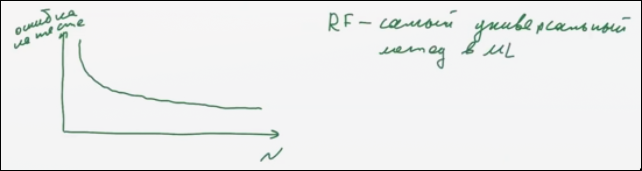  
Подвохи:  
1. Очень долго обучаются
2. Если $bias(b_n)$ >> 0, то RF будет плох  
RF:  
* out-of-bag:  
$b_n(x)$ обучается на $X_n \in X \to$ часть объектов часть из Х - валидация для $b_n$  
OOB = $\frac{1}{\ell}\sum\limits_{i}  ^{\ell}{L(y_i, \frac{1}{\sum{[x_j \notin X]}} \sum\limits_{j}^{N}{[x_j \notin X_n]b_n(x_i)})}$, второй параметр - прогноз для x_i по деревьям, которые на нем не обучались. OOB близка к LOO.  
* Важность предикатов. (перестановка признаков) (общий, не только для деревьев)  
$Q(a, X_{test}) = Q_{test}$. Возьмем jй признак в тесте и перемешаем, не трогая остальные признаки. После этого этот признак бесполезен. Пусть этот X test будет j: $X_{test_j}$. Важность jго признака можно оценить $Q_{test_j}-Q_{test} = q_j$. $q_i \approx 0$ - признак не важен. $q_i > 0$ - признак важный. $q_i < 0$ - какой-то баг...

# Градиентный бустинг  (gradient boosting machine)  
каждая следующая модель корректирует ошибки предыдущих  


__Бустинг для MSE__  
$\frac{1}{\ell} \sum{(a(x) - y_i)^2} \to \min$  
$a_N(x) = \sum\limits_{i} ^N {\gamma_n b_n(x)}, \gamma_n \in \mathbb{R}$, гамма - веса.
$b_1(x): \frac{1}{\ell} \sum {(b_1(x_i) - y_i)^2 \to \min_{b_1}}$. $b_1$ фиксирую для следующих шагов.  
$b_2(x): b_1(x_i) + b_2(x_i) = y_i$  
$b_2(x_i) = y_i - b_1 (x_i) = s_i\text{ (сдвиг)} \in \mathbb{R}$  
$\frac{1}{\ell} \sum{(b_2 (x_i)-s_i)^2} \to \min$  
$\gamma_2 = argmin \frac{1}{\ell} \sum{(b_1(x_i) + \gamma b_2(x_i) - y_i)^2}$  
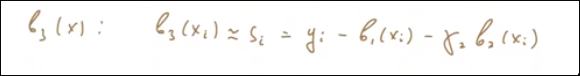  

когда останавливаемся?  
- ГБ переобучается  
- Нужно следить по валидационной выборке   
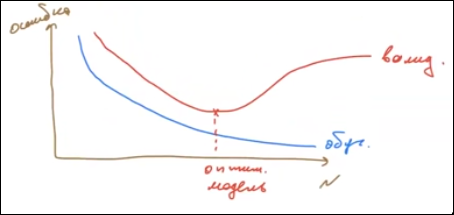

__Общий случчай__  
$L(y, z)$ - дифф.ф-я  
$a_n(x) = \sum{b_n(x)}$  

`как обучать?`  
$b_n(x) : \frac{1}{N}\sum{L(y_i, a_{N_1}(x_i)+b_n(x_i))}\to \min$.  Мы не умеем делать модель хорошей `прибавкой`  
В MSE было просто, потому что:  
$L(y_i, a_{N-1}(x_i)+b_n (x_i)) = L(y_i - a_{N-1}(x_i), b_n(x_i))$, а в общем случае это не выполнено  
$b_1(x)$ -  обучим как можем  
$b_n(x): b_1(x), \dots, b_{N-1}(x)$ - уже есть, зафиксированы.  
Как изобрести прибавку $b_n(x_i)$?  
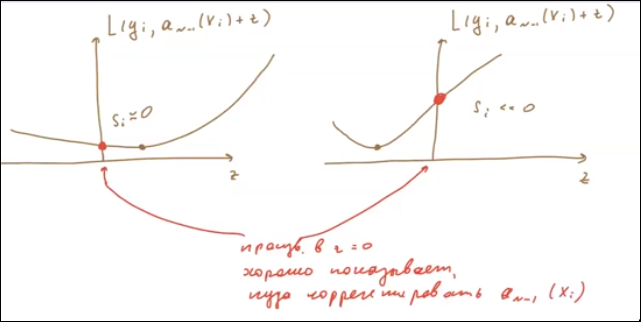  
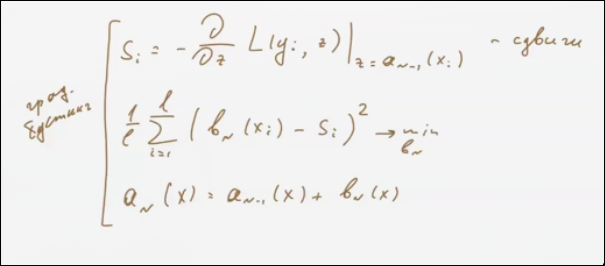  
$Q(z_1, \dots, z_{\ell}) = \frac{1}{\ell}\sum{L(y_i, a_{N-1}(x_i) + z_i)}$  
$(s_1, \dots, s_{\ell}) = - \nabla_z Q(x)$. Я как бы делаю гр. спуск в пространстве прогнозов на обучающей выборке  

Пример:  
$X = ((x_1, y_1), (x_2, y_2))$  
$\frac{1}{2}(L(y_1, z_1) + L(y_2, z_2)) \to \min$  
Линии уровня:  
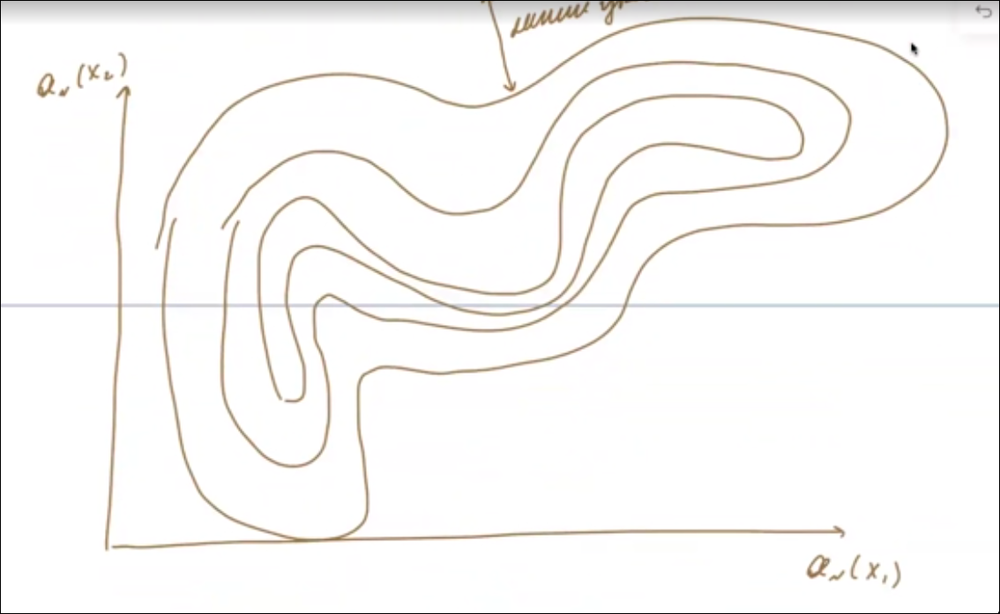  
"базовые модели мы будем использовать тупые". b2 мы будем обучать так, чтобы она примено угадала направление b1.  
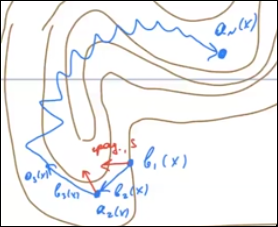  
гр.буст это как бы гр. спуск в пространстве прогнозов композиции на обучающей выборке.  
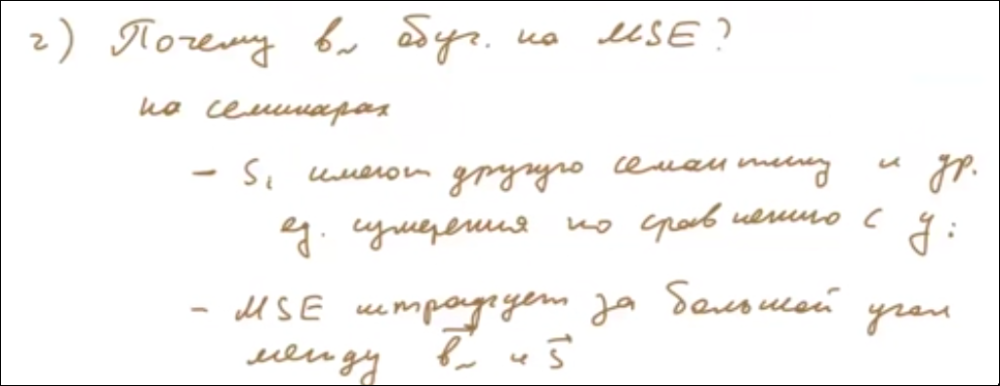  


__Бустинг__  
$b_i(x)$ - слабые  
* Беггинг - усреднение. $a_n(x) = \frac{1}{N}\sum{b_i(x)} $ учим все $b_i(x)$ независимо  
* Бустинг: $a_n(x) = \sum{b_i(x)}$ учим направленно, чтобы каждая следующая модель исправляла ошибки предыдущих  
GBM:  
учим неглубокие деревья, последовательно исправлять ошибки друг-друга.  
$a_N(x) = a_{N-1}(x) + \gamma_N *a_N(x)$. На гамму обучно забивают и без нее работает.  
init: $b_0(x) = 0, \bar y, med(y)$  
$a_N(x) = a_{N-1}(x) + \gamma_N *a_N(x)$  
$\sum{L(y_i, a_{N-1}(x_i) + \gamma_N b_N(x_i)) } \to \min_{\gamma, b_n}$  
1. Псевдоостатки: $s_i = -\frac{\partial{L(y, z)}}{\partial{z}}, z=a_{N-1} (x_i)$  
$b_n(x) = argmin(\sum{(b(x_i) - s_i)^2})$  
2. $\gamma_N = argmin(\sum{L(y_i, a_{N-1}(x_i)+\gamma * b_N(x_i))})$  
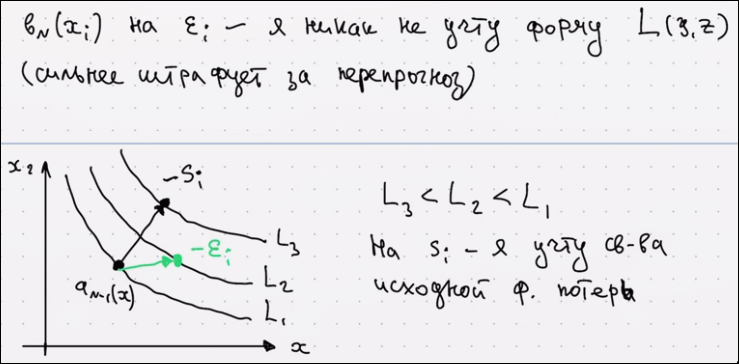  
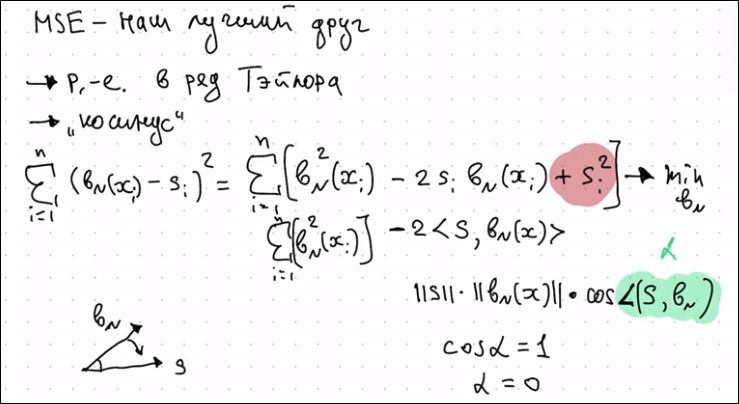  

А что делать с классификацией?  
$L(y, z) = \log(1 + \exp(-y*z)), y \in \{-1, 1\}$  
$\sigma(t) = \frac{1}{1 + \exp(-t)}, \sigma' = \sigma(t)* (1 - \sigma(t))$  
$L(y, z) = \log(\frac{1}{\sigma(y*z)}) = -\log(\sigma(y*z))$  
$s_i = - \frac{\partial{L(y, z)}}{\partial{z}}$, $|\scriptstyle{z = a_{N-1}(x_)}$ $\;\; = \frac{y}{\sigma(y*z)} * \sigma(y*z) * (1 - \sigma(yz))$ $|\scriptstyle{z = a_{N-1}(x_i)}$ $= [1-\sigma(y*a_{N-1}(x_i))] * y_i = \frac{y_i}{1 + \exp{(y_i*a_{N-1}(x_i))}}$  
$1 - \frac{1}{1 + \exp{-t}} = \frac{1}{1 + \exp{t}}$  
$\sum{[b_n(x_i) - \frac{y_i}{1 + exp(y_i * a_{N-1} (x_i))}]^2}\to\min$  
$b_j (x_i) \notin [0, 1], \in \mathbb{R}, a_N (x_i) \in\mathbb{R}$  
$\sigma(b_j(x_i))$ - тогда все хорошо  
$b_j(x_i)$ -  что она прогнозирует?  
$\sigma(b_j(x_i)) = \mathbb{P}(y_i = 1|x_i)$  
$\frac{1}{1 + \exp(-b_j(x_i))}$  
$b_j(x_i) = \ln(\frac{\mathbb{P}(y_i = 1|x_i)}{1 - \mathbb{P}(y_i = 1|x_i)})$ - логит. Каждая модель прогнозирует логит

__Регуляризация__  
Можно показать эмпирически, что в бустинге:  
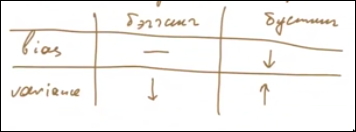  
$\to$ базовые модели в GBM это должны быть не глубокие деревья  
Проблемы с бустингом:  
1. Если базовые модели простые, их качество будет не очень, могут испортить композицию  
2. Если базовые модели сложные, то есть риск моментольно переобучиться  
$\to$ b(x) нельзя доверять  
* `Сокращение шага`. По факту аналог длины шага в гр.спуск  
$a_N(x) = a_{N-1}(x) + \eta * b_n(x)$, это решает наши проблемы с  GBM. $\eta$ - гиперпараметр (важный), чем меньше ее значение, тем больше будет оптимальное значение N.  

__Стохастический град.бустинг__  
Давайте базовую модель обучать не на всей выборке, а на части.  
Модели простые (низкая емкость), а данные большие и сложные  
Идея: обучаем $b_n(x)$ по $X_n \in X$, $|X_n|$ - гиперпараметр  
* Функция потерь:
1. Регрессия:  
$L(y, z) = \frac{1}{2} \sum{(y - z)^2}$  
$s_i = - \frac{\partial{L}}{\partial{z}} (y_i, z)$ $| \scriptstyle{z = a_{N-1}(x_i)}$ $= y_i - a_{N-1}(x_i )$  
$L(y, z) = |y - z|$  
$s_i=-sign\;\;(a_{N-1}(x_i) - y_i)$  
2. Классификация  
$a_N(x) \in \mathbb{R}$ - уверенность в положительном классе  
$sign\;\;a_N(x)$ - итоговый класс  
$L(y, z) = log(1+\exp(-y*z))$  
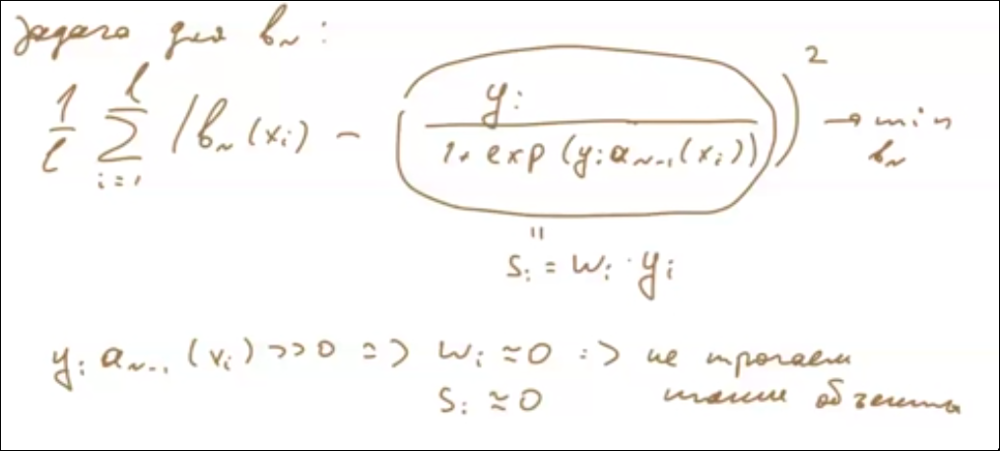  
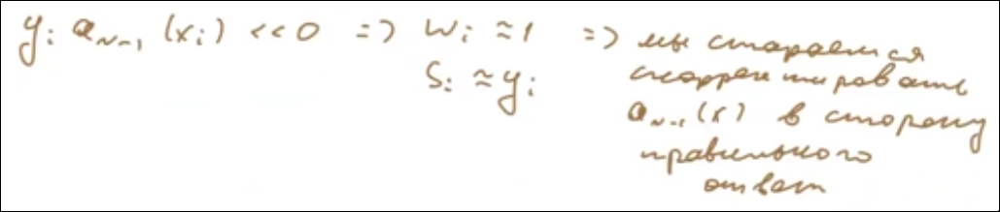  
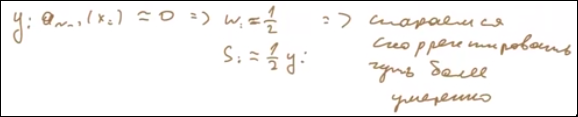  


__Градиентый бустинг над деревьями (GBDT)__  
$b_n(x) = \sum\limits_{j=1}^{J}{(b_{nj}[x \in \mathbb{R}])}$  
$a_N(x) = a_{N-1}(x) + \sum\limits_{j=1}^{J}{(b_{nj}[x \in \mathbb{R}])}$  
Идея: подберем $b_{nj}$, чтобы они были оптимальны с т.з. L(y,z)  
$\sum{(L(y_i, a_{N-1}(x_i)) + \sum{\gamma_j \;\;[x_i \in R_{nj}]})}$  
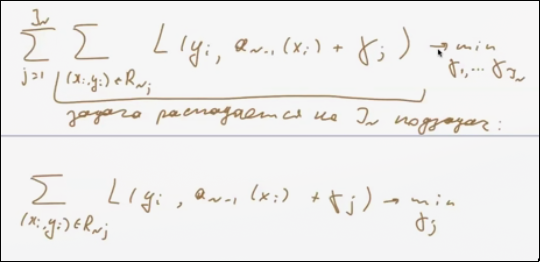  
- одномерная оптимизация  
Пример:  
$L(y, z) = \log(1 + \exp(-y*z))$  
$\sum{\log(1 + \exp(-y_i*(a_{N-1} (x_i) + \gamma_j)))}$  
сделаем 1 шаг метода Ньютона-Рафсона  
$$\gamma_j = - \frac{\sum{s_i}}{\sum{|s_i| *(1 - |s_i|)}}$$  
длина шага не отменяется

__Разное__  
* Взвешивание  
в классификации почти всегдa:  
$L(y, z) = \tilde L (yz)$ (ф.п. зависят от отступа)  
тогда: $s_i = y_i (- \frac{\partial{\tilde{L}}}{\partial{\mu}} \;(\mu))$ $|\scriptstyle{\mu = y_i*a_{N-1}(x_i)}$. То есть отступ это класс*коэф  
* Устойчивость к выбросам  
экспоненциальная: $L(y, z) = e^{-y*z}$  
$s_i = y_i * \exp(-y_i * a_{N-1}(x_i))$. Если отступ большой отрицательный, от вес уходит в бесконечность. На устойчивость к выбросам надо исследовать наши функции потерь

__Бустинг второго порядка__  
обучение N-й модели:  
$\sum{L(y_i, a_{N-1}(x_i) + b_N (x_i))}$  
а давайте разложим в ряд Тейлора с центром $a_{N-1}(x_i)$ до второго члена  
$\sum{(L(y_i, a_{N-1}(x_i)))} + \frac{\partial}{\partial{z}} \; L(y_i, z)$ $|\scriptstyle{\mu = y_i*a_{N-1}(x_i)}$ $*b_n(x_i) + \frac{1}{2} * \frac{\partial^2}{\partial{z^2}} L(y_i, z)$ $|\scriptstyle{\mu = y_i*a_{N-1}(x_i)}$ $b_n ^2(x_i)$  
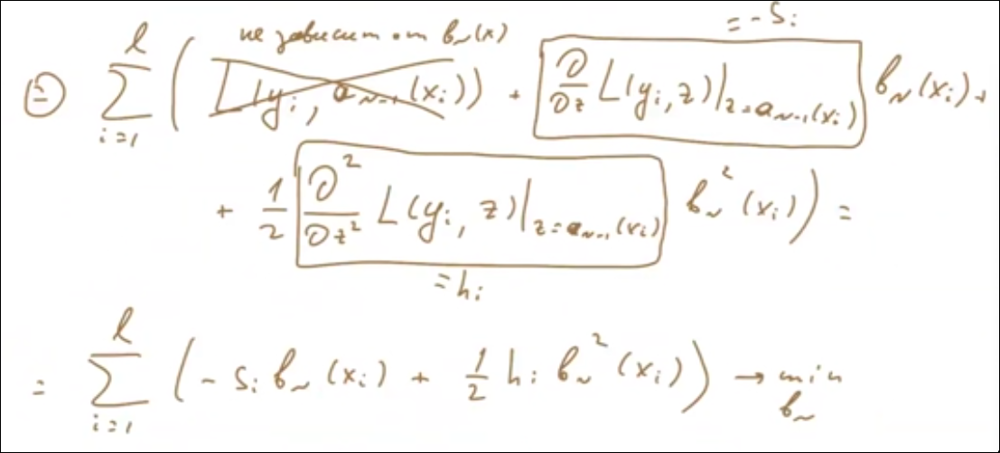  
Раньше мы оптимизировали MSE $b_n(x_i), s_i$, $\sum{(b_n (x_i) - s_i)^2} = \sum{(b_n(x_i) ^2 - 2*s_i * b_n(x_i) + s_i^2)} = \sum{-s_i * b_n(x_i) + \frac{1}{2} * b_n^2(x_i)}\to \min$  
Инновация: учитывает вторую производную, она про 'кривизну' (вспоминает информацию Фишера)

__Еще несколько способов регуляризовать бустинг__  
$b(x) = \sum{(b_j [x\in R_j])}$  
показатели сложности дерева:  
1.  J -  число листьев  
2. $||b||^2 = \sum{b_j ^2}$ - прогнозы в листьях, чем больше, тем выше шансы изменения композиции  
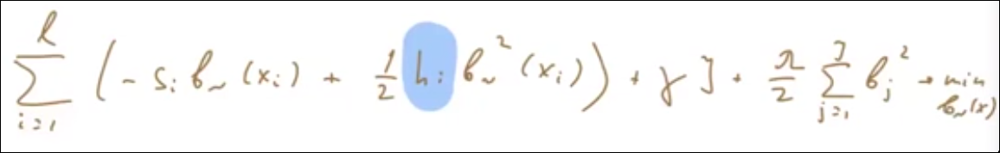  
Пусть структура дерева фиксирована. Чему тогда равны оптимальные прогнозы в листьях?  
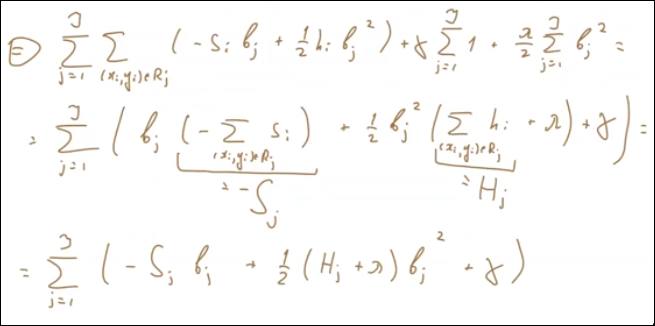  
$S_j$ - фиксированно, а по $b_j$ это квадратный многочлен, значит можно найти оптимум: $b_j ^{*} = \frac{S_j}{H_j + \lambda}$, подставим  
$= - \frac{1}{2} \sum{(\frac{S_j ^2}{H_j + \lambda} + \gamma * J)} = H(b)$ - функционал при оптимальных прогнозах в листьях.  
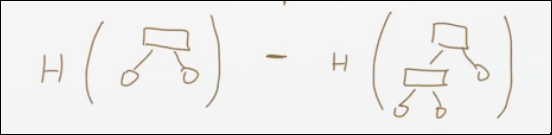  
Мы можем понять как изменяется ошибка при добавлении нового предиката, а значит получаем механизм построения дерева. Будем использовать H(b) в качестве impurity!   
$Q(R, j, t) = H(R) - H(R_l) - H(R_r)$  
Что сделали:  
1. Учли вторые производные  
2. Добавили регуляризацию
3. ввели специальную impurity напрямую зависящую от функции потерь

__Сложность__  
$O(N*T_{tree})$  
в вершине i $O(d*n_i)$  
Обучение дерева стоит: $O(T_{tree}) = O(n*d*depth)$  
Сложность обучения бустинга по времени: $O(N*n*d*depth)$  
Прогнозирование: $O(n*depth)$ 
глубина в бустинге маленькая, а в лесу большая  
Сложность обучения леса: $O(N*n*d*depth)$  
Прогноз(1) леса: $O(n*depth)$  


__Бустинги бывают разными__  
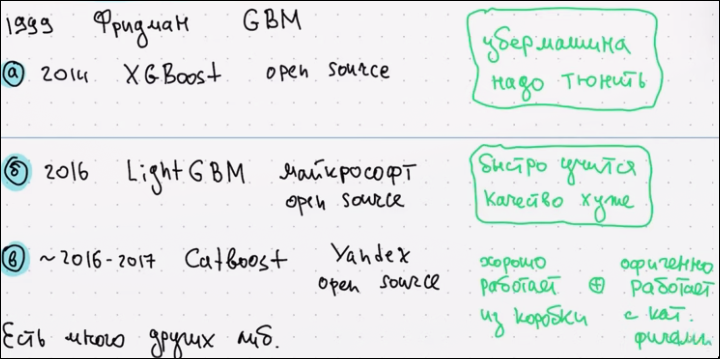  
Отличия:  
- Можно по-разному строить деревья:  
1. XGBoost: симметричные бинарные деревья. (level-wise approach)  
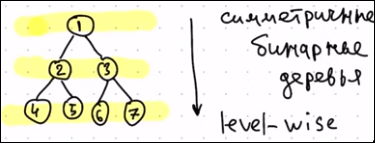
2. LightGMB:  
max_leaf = 9, фиксируем, строим деревья жадно и в глубину  
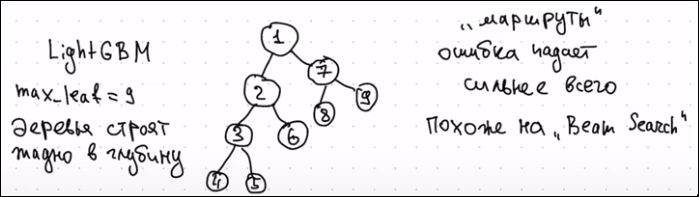
3. Catboost: тоже бинарные, тоже симметричные, но на каждом уровне будем использовать одинаковые правила разбиния  
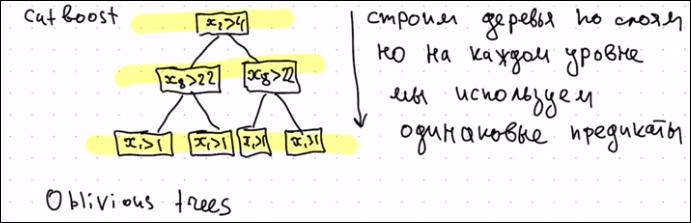  
Нах так делать?  
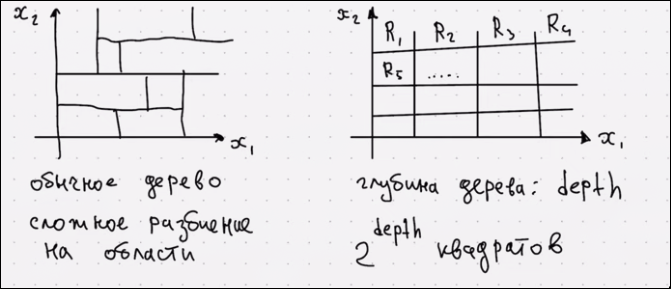  
Можно распаралелить вычисления. Делаем прогнозы для кажого уровня параллельно. Можно хранить дерево как хэш-таблицу  
- Подбор порога для разбиения
1. Жадный перебор  
Долго(  
2. Случайный перебор  
3. Байес/Гауссовские процессы  
4. Можно сделать решетку для перебора поменьше  
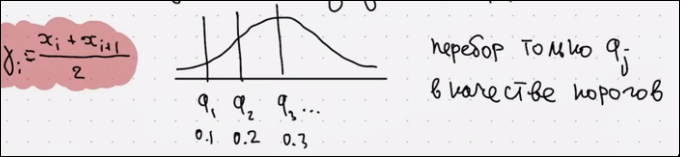  
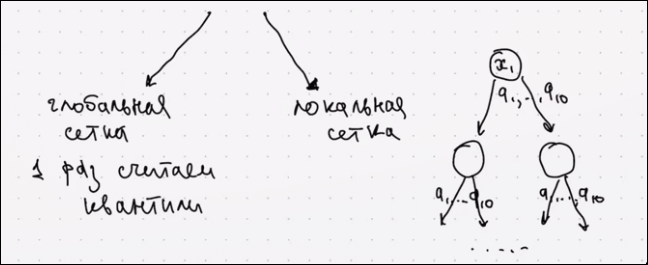  
Схема изначально была в XGBoost  
5. Способ LightGBM. Хочется, чтобы псевдоостатки уменьшались:  
$|s_i|\downarrow$. А давайте отсортируем наблюдения по $|s_i|$. Ставим черту и семплируем из каждой части. Делаем перебор порогов в рамках семпла. Надо будет домноэить градиенты на пропорцию $\frac{1 - q}{b}$  при расчете критерия информативности  
- Предобработка переменных  
CatBoost хорош с кат.фичами  
  - OHE
  - Order Encoding
  - Target Encoding  
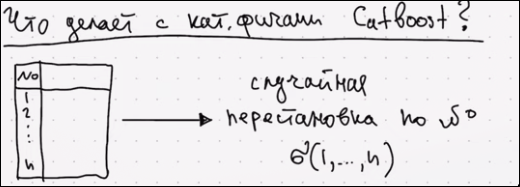  
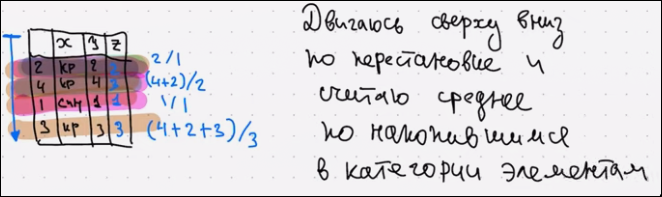  
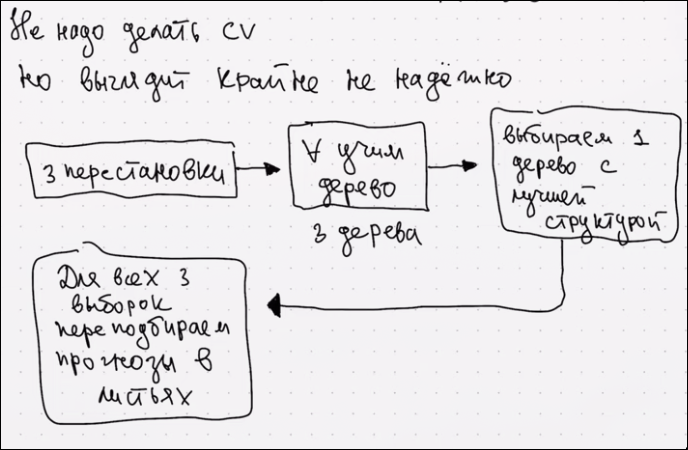

__Стекинг__  
Пока строили линейные композиции.  
$a_N(x) = \sum{\gamma_n * b_n(x)}$  
Бывает сложнее:  
$a_N(x) = \sum{\gamma_n (x) * b_n(x)}$. $\gamma_n (x)$ - показатель компетентности $b_n(x)$ в точке x.  
совсем сложное - стекинг  
$b_1(x), \dots b_n(x)$ -  базовые модели, возможно из разных семейств.  
$a(b_1(x), \dots b_n(x))$ - метамодель. прогнозы бэшек содержат информацию про ответы на обучающей выборке и обучать a(x) той же выборке - переобучение и утечка. Как бороться с переобучением a(x)?  
$X = X_1 \cup \dots \cup X_k$.   $\; \; b_n ^{-k} (x) = b_n(x)$ обученная на $X\backslash X_k$  
$\sum\limits_{n = 1} ^K {\sum\limits_{(x_i, y_i)\in X_n}{L(y_i, a[b_1 ^{-k} (x_i), \dots, b_n ^ {-k} (x_i) ])}} \to \min$  
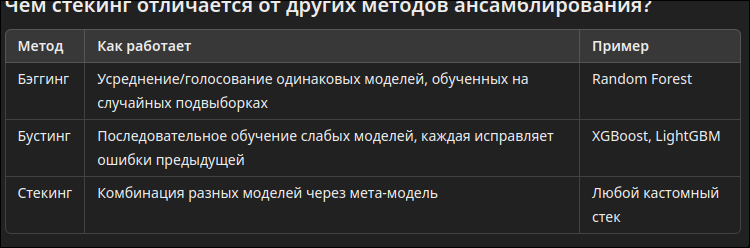

# Обучение без учителя  
раньше: $(x_i, y_i) ^{\ell}, a(x_i) \approx y_i, y_i$ определяет конкретную задачу.  
теперь: $X = (x_i)^{\ell}$. Хотим что найти из x, найти структуру в X, не зная правильных ответов  


# Кластеризация  
$X = (x_i)^{\ell} _{i=1}$  
$Хотим: a: \mathbb{X} \to {1, \dots, K}$ - модель кластеризации.  
$x_i, x_j \text{ если похожи, то } a(x_i)=a(x_j)$. K - не знаем  
Зачем это надо?  
1. Разведочный анализ данных  
2. Генерация признаков  
3. Квантизация признаков, можем заменить значение $x_j$ на центр кластера; заменить объект на центр кластера  
4. Продуктовые задачи: кластеризация новостей...  

__Метрики качества кластеризации__  
* Лучший способ: посмотреть глазами  
1. Внутрикластерное расстояние.  
$C_k$ - центр k-го кластера  
$\sum\limits_{k = 1} ^ K{\sum\limits_{i=1} ^{\ell}{([a(x_i) =k]) \rho(x_i, c_k)}} \to \min$
2. Межкластерное расстояние  
$\sum\limits_{i \neq j}{([a(x_i) \neq a(x_j)] \rho(x_i, x_j))} \to \max$   
3. Индекс Данна  
$d(k, k')$ - расстояние между кластерами k и k'  
$d(k)$ - внутрикластерное расстояние  
$\frac{\min\limits_{1 \geq k \geq k' \geq K}(d(k, k'))}{max(d(u))}\to \max$

__Выбор числа кластеров__  
* Где-то метод сам подбирает число кластеров  
* Где-то это гиперпараметр  
Elbow method  
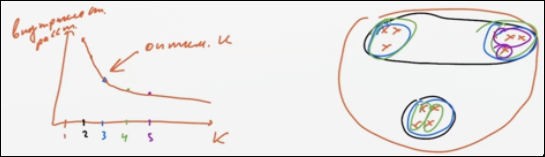 
ищем локоть  
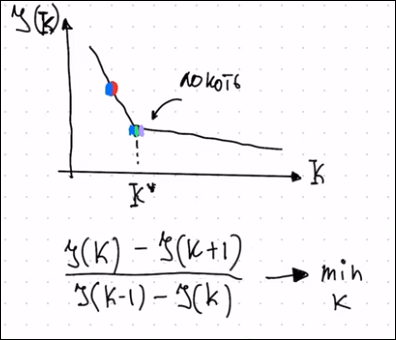
* Метрические методы  
$\rho(x, z) - расстояния$  



__K-means__  
к-гиперпараметр  
$\sum\limits{k = 1} ^{K} \sum\limits_{i=1}^{\ell}{[a(x_i) = k] \rho(x_i, C_k)}\to \min$  
Идея: поочередно оптимизировать по $a(x)$ и $C_k$  
`Шаг 0`: инициализируем центры $C_k$ (напримерм, k-means++)  
`Шаг 1`: фиксируем центры $C_k$ и оптимизируем по меткам кластеров, $a(x_i) = argmin\;\rho(x_i, C_k)$. Относимм точку к тому кластеру, чей центр ближайший  
`Шаг 2`: Фикс. $a(x_i)$. $C_k = argmin\;\; \sum{\rho(x_i, c)}$. То есть я выбираю центр для каждого кластера такой, чтобы внутрикластерное расстояние было минимальным  
Если $\rho = ||x-c||_2^2$, то $C_k = \frac{1}{\sum{[a(x_i) = k]}} \sum{[a(x_i) = k] * x_i}$
`Выполняем шаги до сходимости`.  В KMeans сходимость гарантируется.  
(+) быстрый, легко параллелится  
(-) зависит от инициализации, если признаки разного масштаба, то можем чето не то выйти, слишком простая форма кластера  
С таким не справится  
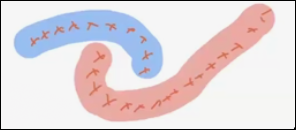

__Плотностый метод__  
DBSCAN  
два гиперпараметра: $\epsilon$, n  
идея: ищем плотные кластеры  
Типы объектов:  
1. Ядровые
2. Пограничные. Не ядровые, но содержат ядровой объект в $\epsilon$ окр
3. Остальные  
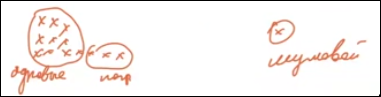  
Алгоритм:  
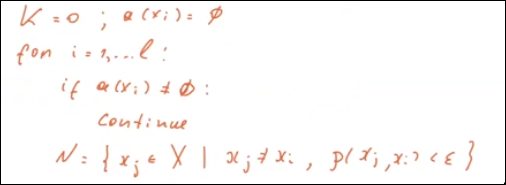  
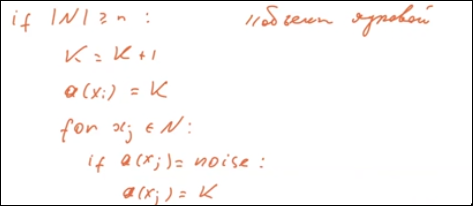  
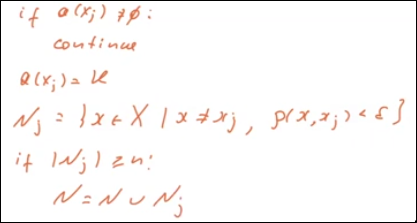  
(+) помогает находить кластеры любой формы. $\epsilon$, n сильно легче подбирать  
(-) долгий оч, плохо параллелится, плохо обрабатывает кластеры разной плотности  
Есть еще `OPTICS`. Позволяет иметь разные плотности кластеров

__Иерархические подход (Агломеративная кластеризация)__  
$С^1 = { {x_1}, \dots, {x_{\ell}}}$  
$\vdots$  
$С^j = { {x_1 ^J}, \dots, {x_{\ell - j + 1} ^j}}$  
$d(X_m, X_n)$ - мера близости Xn, Xm как кластеров  
$(m,n) = argmin\;\;d(X_m ^j, X_n ^j)$  
$C ^{j+1} = C^{j} \backslash \{X_m ^j, X_n \}\cup \{\{X_m ^j \cup X_n \}\}$  
$C^{\ell} = {{x_1, \dots, x_{\ell}}}$  
Изображается дендограмма

__Mean shift__  
Я хочу, чтобы были центры кластеров, они были выпуклы. Хочу отступать от него на какой-то радиус, и что попало - хорошо, и чем больше, тем лучше. А все, что не попало - не очень хорошо, он должен учитываться с более низким весом. Ближе - больше вес.  
$N(C) = \{x \in \mathbb{X} \;|\;||x-c|| < \epsilon \}$, $\{c_1, \dots, c_k\}$ - центры кластеров  
Центры масс для кластера  

$$\mu(c) = \frac{(\sum{x_i}) *\mathcal{K}(x_i - c)}{\sum{\mathcal{K}(x_i - c)}}$$  
$$\mathcal{K} - \text{ядро, например гауссово}$$  
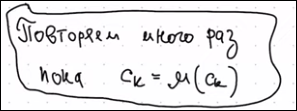

__Метрика силуэта__  
давайте посчитаем расстояние от $x_j$ до $x_i$.  
$\rho(x_i, x_j^{c_1})$  
Устредним. $a(x_i) = \frac{1}{|c_1|} \sum{\rho(x_i, z)}$.  
Возьмем ближайший кластер к $x_i$, $\rho(x_i, x_j ^{c_2})$. $b(x_i) = \frac{1}{|c_2|} \sum{\rho(x_i, z)}$  

$s(x_i) = \frac{b(x_i) - a(x_i)}{\max{(a(x_i), b(x_i))}}$ -  силуэт объекта  
$S = \frac{1}{n} \sum{s(x_i)}$ - силуэт по выборке  
$S \in [-1; 1]$.  Если мы близки к -1, то кластеризация оказалась плохой, она оказалась разрозненной. Если к 1, то кластеры хорошие. Если к 0, то кластеры пересекаются, накладываются друг на друга

## SVD  
* $A_{n \times n}$ если у нее $\exist n $ линейно нез. соб. векторов в $\mathbb{R}$  
тогда: $A_{n \times n} = P * D^{-1} * P^{-1}$  
* $A_{n \times n}$: $A^{T} = A$ + у нее $\exist n$ ортогональных собственных векторов ед. длины  
$A = P * D * P^{T}$, $P*P^{T} = I$, $P^{-1}$  
* Если n нез. соб. векторов не нашлось, то тогда можно спастись Жордановой формой 
* SVD Любую матрицу можно представить в виде:  
$A = U \Sigma V^{T}$  
* Разложение Холецкого: $A: A = A^{T}, A  \succ 0  $. Тогда $\exist P: A = P * P^{t}$.  Если P - нижнетреугольная, тогда она единственна. 'Квадратный корень матрицы', перодически используют для перехода от ковариационной матрицы к стандартному отклонению.
* SVD есть всегда. U и V ортогональны. $\sigma$ - диагональная  
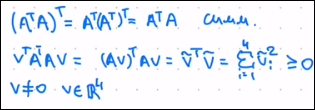  
$A*A^{T}$ симметричная и положительно определенная. А значит, у нее есть спектральное разложение. $A*A^{T} = V * \Sigma * U^{T} * U * \Sigma * V^{T}$. $U^{T} * U = I$, так как U ортогональное   
$ = V * \Sigma^{T} * \Sigma * V^{T} = V * D * V^{T}$  - а это спектральное разложение. А оно всегда есть, а значит и SVD всегда тоже есть.  
1. $A^{T} * A = V * D * V^{T}$. Собств. век, соб. зн  
$A * A^{T} = U*D_1*U^{T}$. 
2. U -  знаю, $\Sigma$ - знаю, $\sigma_1 = \sqrt{\lambda_i} \text{из} D_1$  
$A = V*\Sigma* \textcolor{red}{V^{T}\;\;?}$. $(V * \Sigma)^{-1} * A = V^{T}$  
$\Sigma^{-1}* U^{T} * A = V^{T}$  
$v^{T} _i = \frac{u^{T} _i * A}{\sigma_i}$. Алгоритм всегда можно сделать руками на бумаге, но в компе это будет очень долго -> комп считает по другому

## Немного статистики  
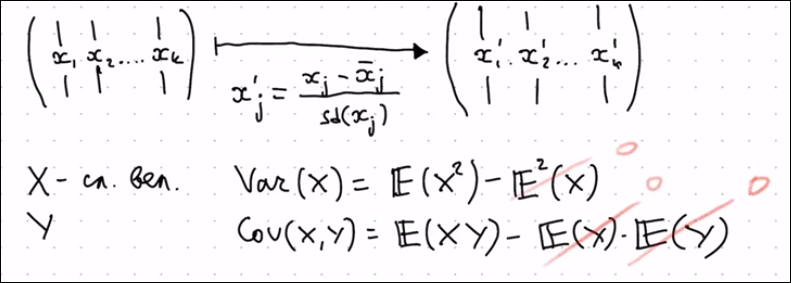  

$\hat{Var} (x_i) = \bar{x^2 _i}$  
$\hat{Var} (x_i) = \frac{x^{T}_i * x_1}{n - 1 } = \frac{\sum{x^2 _i}}{n - 1 }$  
$\hat{Cov}(x_1, x_2) = \frac{x_1 ^{T}*x_2}{n-1}$  
$\hat{C} = \frac{X ^{'T} * X'}{n - 1}  $  
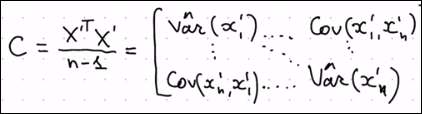

## Три взгляда на PCA  
Алгоритм линеен(!)
1. Максимизация дисперсии  
$X = [||\dots |]_{n \times D} \to \tilde{X}_{n \times d}, D \ggg d$. Сохранить как можно больше инфы  
$z_1 = u_{1\;1} * x_1 + u_{1\;2} * x_2$  
$z_1 = X * u_1$  
$\hat{Var} (z_1) = z^T _1 * z_1 = u^T _1 * X^T * X * u_1 \to \max$  
and $||u_1||^2 = u_1 ^T * u_1 = 1$  
$\mathcal{L}(u_1, \lambda) = u^T _1 * X^T *X*u_1 - \lambda (u_1 ^T * u_1 - 1)$  
$\frac{\partial{\mathcal{L}}}{\partial{u_1}} = 2* X^T * X * u_1 - 2 \lambda *u_1 = 0$  
$X^T *X*u_1 = \lambda * u_1 \;\;:\;\; A * v = \lambda v$, u -собств. век. $\lambda$ - собств.зн.. $u_1$ - соб.вектор для $\lambda_{max}$, так как для нее будет максимальная дисперсия  
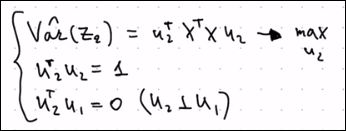  
Можем выписать лагранжан и u2 - вектор соотв лямбде2  
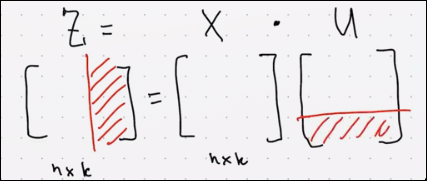  
ВАЖНО, ЧТОБЫ ИКСЫ БЫЛИ СТАНДАРТИЗИРОВАНЫ. PCА чувствителен к выбросам  
2. С точки зрения SVD  
$X = U* \Sigma * V^T$  
$Z = X*V = U * \Sigma$, Х - наблюдения, V - веса, а $U*\Sigma$ -  Z  
$Z^T * Z = \Sigma ^T *U^T*U *\Sigma = \Sigma^T *\Sigma$ -  матрица, где по диагоали лямбды  
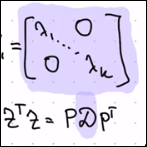  
$Var(Z) = \frac{Z^T * Z}{n - 1}$  
$Var(z_k) = \lambda_k$. То есть, чтобы максимизировать дисперсию, надо взять максимальное собств. зн.  
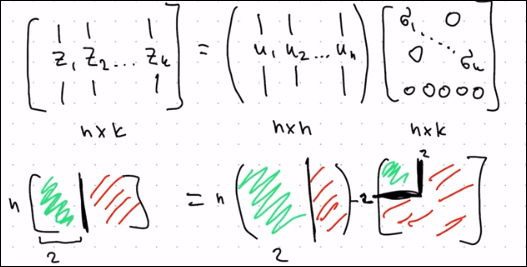  
3. PCA с т.з. низкоранговых приближений  
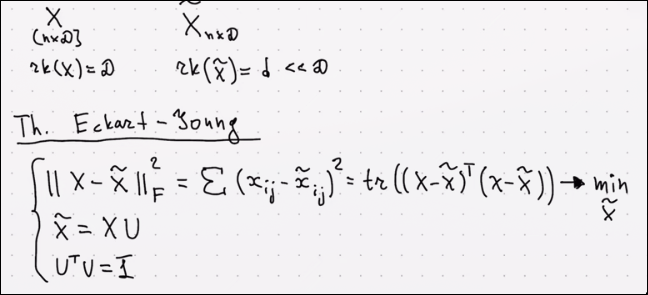  
Решение: SVD  
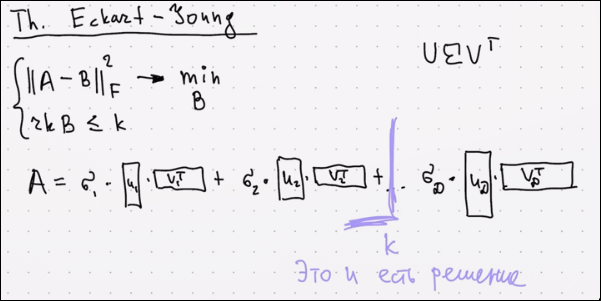  
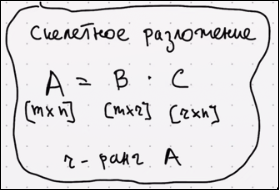  
Как выбрать k?, долю дисперсии, которую мы объяснили. Возпользуемся методом локтя. Допустим, объяснили более 90%, то останавливаемся.  

__Формы SVD__  
1.  
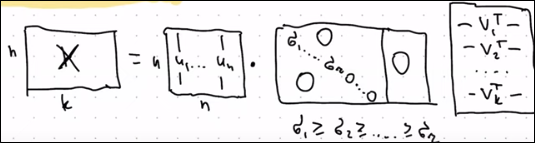  
2. Усеченное SVD  
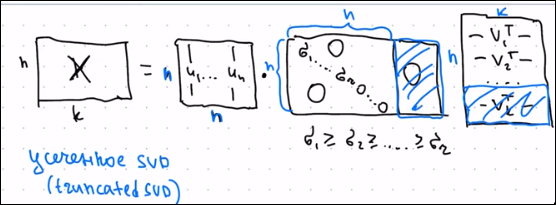  
3. Компактед SVD  
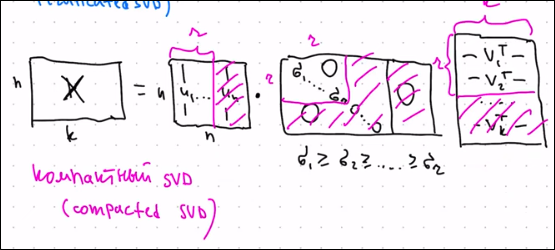

# А здесь секция, таки с кодом

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import warnings
from sklearn.linear_model import LinearRegression

warnings.simplefilter("ignore")
%matplotlib inline

sns.set(style="darkgrid")

In [9]:
data = pd.read_csv("train_sem2.csv")
from sklearn.model_selection import train_test_split

data = data.drop(columns=["Id"])

y = data["SalePrice"]
X = data.drop(columns=["SalePrice"])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=10)

In [10]:
numeric_data = X_train.select_dtypes([np.number])
numeric_data_mean = numeric_data.mean()
numeric_features = numeric_data.columns

X_train = X_train.fillna(numeric_data_mean)
X_test = X_test.fillna(numeric_data_mean)

In [13]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error

model = Ridge()
model.fit(X_train[numeric_features], y_train)
y_pred = model.predict(X_test[numeric_features])
y_train_pred = model.predict(X_train[numeric_features])

print("Test RMSE = %.4f" % mean_squared_error(y_test, y_pred))
print("Train RMSE = %.4f" % mean_squared_error(y_train, y_train_pred))

Test RMSE = 1029496516.9834
Train RMSE = 1269590472.7712


In [14]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(model, X_train[numeric_features], y_train, cv=10, scoring="neg_root_mean_squared_error")
print("Cross validation scores:\n\t", "\n\t".join("%.4f" % x for x in cv_scores))
print("Mean CV MSE = %.4f" % np.mean(-cv_scores))

Cross validation scores:
	 -38825.3172
	-45278.9230
	-31405.3380
	-33890.1048
	-73848.3061
	-24142.7915
	-45523.7066
	-52861.2908
	-26094.3376
	-29693.5005
Mean CV MSE = 40156.3616


* А можно вот так и предсказывать

In [15]:
from sklearn.model_selection import cross_validate
cv_results = cross_validate(model, X_train[numeric_features], y_train, cv=5, return_estimator=True)

trained_models = cv_results['estimator']

predictions = trained_models[0].predict(X_test[numeric_features])

In [17]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train[numeric_features])
X_test_scaled = scaler.transform(X_test[numeric_features])

model = Ridge()
model.fit(X_train_scaled, y_train)
y_pred = model.predict(X_test_scaled)
y_train_pred = model.predict(X_train_scaled)

print("Test RMSE = %.4f" % mean_squared_error(y_test, y_pred))
print("Train RMSE = %.4f" % mean_squared_error(y_train, y_train_pred))

Test RMSE = 1029467441.6893
Train RMSE = 1269583555.3863


In [18]:
from sklearn.model_selection import GridSearchCV

alphas = np.logspace(-2, 3, 20)
searcher = GridSearchCV(Ridge(), [{"alpha": alphas}], scoring="neg_root_mean_squared_error", cv=10, n_jobs=-1) # n_jobs - сколько потоков одновременно можно запустить
searcher.fit(X_train_scaled, y_train)

best_alpha = searcher.best_params_["alpha"]
print("Best alpha = %.4f" % best_alpha)


Best alpha = 297.6351


In [19]:
from sklearn.pipeline import Pipeline

simple_pipeline = Pipeline([
    ('scaling', StandardScaler()),
    ('regression', Ridge(best_alpha))
])

model = simple_pipeline.fit(X_train[numeric_features], y_train)
y_pred = model.predict(X_test[numeric_features])
print("Test RMSE = %.4f" % mean_squared_error(y_test, y_pred))

Test RMSE = 1005102973.0729


In [20]:
categorical = list(X_train.dtypes[X_train.dtypes == "object"].index)
X_train[categorical] = X_train[categorical].fillna("NotGiven")
X_test[categorical] = X_test[categorical].fillna("NotGiven")

from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(handle_unknown="ignore"), categorical),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('ohe_and_scaling', column_transformer),
    ('regression', Ridge())
])

model = pipeline.fit(X_train, y_train)
y_pred = model.predict(X_test)
print("Test RMSE = %.4f" % mean_squared_error(y_test, y_pred))

Test RMSE = 679722126.2872


In [21]:
alphas = np.logspace(-2, 4, 20)
searcher = GridSearchCV(pipeline, [{"regression__alpha": alphas}],
                        scoring="neg_root_mean_squared_error", cv=10, n_jobs=-1)
searcher.fit(X_train, y_train)

best_alpha = searcher.best_params_["regression__alpha"]
print("Best alpha = %.4f" % best_alpha)

Best alpha = 29.7635


Визуализируем остатки

(0.0, 50.0)

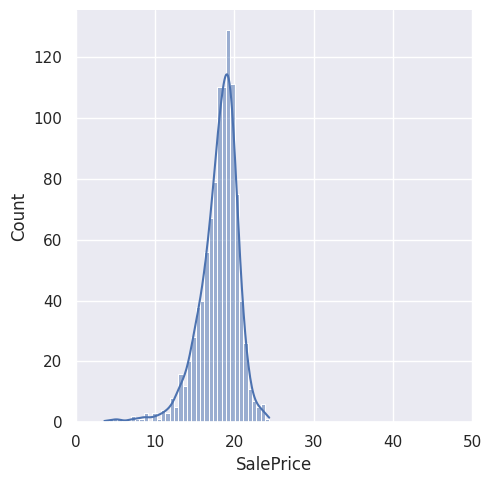

In [24]:
error = (y_train - model.predict(X_train)) ** 2
sns.displot(np.log(error), kde=True);
plt.xlim(0, 50)

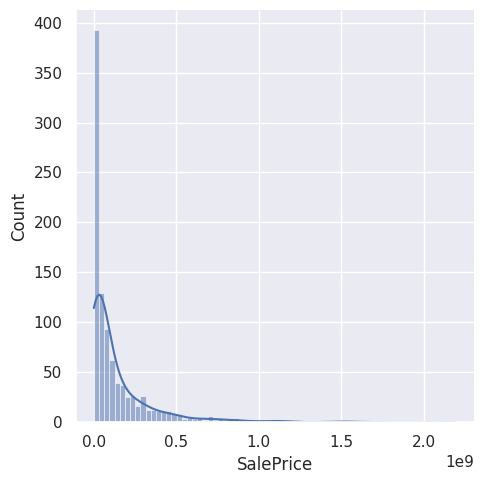

In [25]:
mask = (error < np.quantile(error, 0.95))
model = pipeline.fit(X_train[mask], y_train[mask])
y_pred = model.predict(X_test)
X_train = X_train[mask]
y_train = y_train[mask]
error = (y_train[mask] - model.predict(X_train[mask])) ** 2
sns.displot(error, kde=True);

Полиномиальный фичи


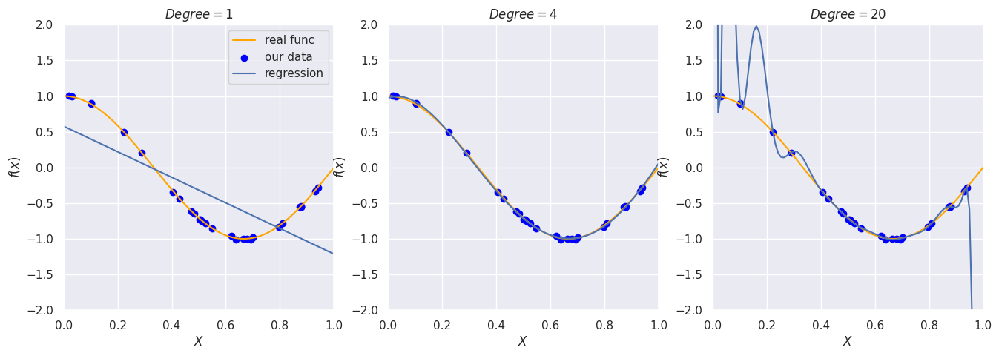

In [26]:
from sklearn.preprocessing import PolynomialFeatures

x = np.linspace(0, 1, 100)
y = np.cos(1.5 * np.pi * x)

x_obj = np.random.uniform(0, 1, 30)
y_obj = np.cos(1.5 * np.pi * x_obj) + np.random.normal(scale = 0.01, size=len(x_obj))

fig, axs = plt.subplots(figsize=(16, 5), ncols=3)

for i, deg in enumerate([1, 4, 20]):
    X = PolynomialFeatures(degree=deg, include_bias=False).fit_transform(x[:, None])
    X_obj = PolynomialFeatures(degree=deg, include_bias=False).fit_transform(x_obj[:, None])
    reg = LinearRegression().fit(X_obj, y_obj)
    y_pred = reg.predict(X)
    axs[i].plot(x, y, color='orange', label='real func')
    axs[i].scatter(x_obj, y_obj, color='blue', label='our data')
    axs[i].plot(x, y_pred, label='regression')
    if i == 0:
        axs[i].legend()
    axs[i].set_xlim(0, 1)
    axs[i].set_ylim(-2, 2)
    axs[i].set_ylabel('$ f(x)$')
    axs[i].set_xlabel('$X$')
    # print(deg)
    axs[i].set_title("$Degree = %d$" % deg)

Дискретизация

In [27]:
from sklearn.preprocessing import KBinsDiscretizer

(-2.0, 2.0)

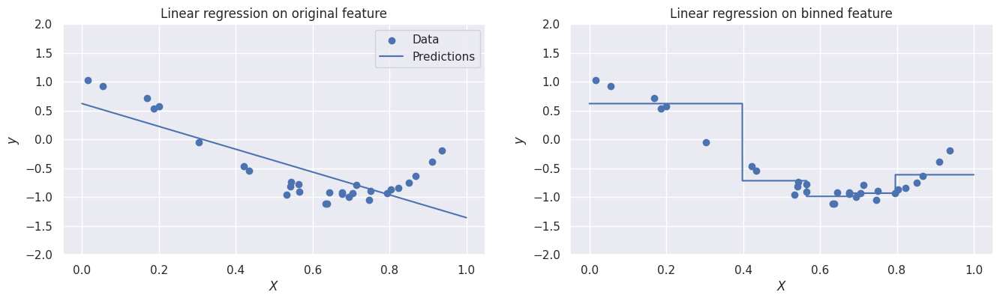

In [28]:
x_plot = np.linspace(0, 1, 10000)

X = np.random.uniform(0, 1, size=30)
y = np.cos(1.5 * np.pi * X) + np.random.normal(scale=0.1, size=X.shape)

fig, axs = plt.subplots(figsize=(16, 4), ncols=2)

regr = LinearRegression()
regr.fit(X[:, np.newaxis], y)
y_pred_regr = regr.predict(x_plot[:, np.newaxis])
axs[0].scatter(X[:, np.newaxis], y, label="Data")
axs[0].plot(x_plot, y_pred_regr, label="Predictions")
axs[0].legend()
axs[0].set_title("Linear regression on original feature")
axs[0].set_xlabel("$X$")
axs[0].set_ylabel("$y$")
axs[0].set_ylim(-2, 2)

binner = KBinsDiscretizer(n_bins=5, strategy='quantile')
pipeline = Pipeline(steps=[
    ('binning', binner),
    ('regression', LinearRegression())
])
pipeline.fit(X[:, np.newaxis], y)
y_pred_binned = pipeline.predict(x_plot[:, np.newaxis])
axs[1].scatter(X[:, np.newaxis], y, label="Data")
axs[1].plot(x_plot, y_pred_binned, label="Predictions")
axs[1].set_title("Linear regression on binned feature")
axs[1].set_xlabel("$X$")
axs[1].set_ylabel("$y$")
axs[1].set_ylim(-2, 2)

In [29]:
from sklearn.preprocessing import QuantileTransformer, quantile_transform
from sklearn.linear_model import RidgeCV
from sklearn.compose import TransformedTargetRegressor
# y_trans = quantile_transform(dataset.data[:, target],
#                              n_quantiles=300,
#                              output_distribution='normal',
#                              copy=True).squeeze()
regr_trans = TransformedTargetRegressor(
    regressor=RidgeCV(),
    transformer=QuantileTransformer(n_quantiles=300,
                                    output_distribution='normal'))

### НО это какая-то шняга лоол))) зачем такое исполнять, если есть деревья?)))


In [30]:
from sklearn.metrics import mean_squared_error, accuracy_score
from sklearn.datasets import fetch_20newsgroups

data = fetch_20newsgroups(subset='all', categories=['comp.graphics', 'sci.med'])
texts = data['data']
target = data['target']
texts_train, texts_test, y_train, y_test = train_test_split(
    texts, target, test_size=0.2, random_state=10
)

### Bag-of-words

Самый очевидный способ формирования признакового описания текстов — векторизация. Пусть у нас имеется коллекция текстов $D = \{d_i\}_{i=1}^l$ и словарь всех слов, встречающихся в выборке $V = \{v_j\}_{j=1}^d.$ В этом случае некоторый текст $d_i$ описывается вектором $(x_{ij})_{j=1}^d,$ где
$$x_{ij} = \sum_{v \in d_i} [v = v_j].$$

Таким образом, текст $d_i$ описывается вектором количества вхождений каждого слова из словаря в данный текст.

In [31]:
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer(encoding='utf8')
_ = vectorizer.fit(texts_train)
len(vectorizer.vocabulary_)

29227

### TF-IDF

Ещё один способ работы с текстовыми данными — [TF-IDF](https://en.wikipedia.org/wiki/Tf–idf) (**T**erm **F**requency–**I**nverse **D**ocument **F**requency). Рассмотрим коллекцию текстов $D$.  Для каждого уникального слова $t$ из документа $d \in D$ вычислим следующие величины:

1. Term Frequency – количество вхождений слова в отношении к общему числу слов в тексте:
$$\text{tf}(t, d) = \frac{n_{td}}{\sum_{t \in d} n_{td}},$$
где $n_{td}$ — количество вхождений слова $t$ в текст $d$.
1. Inverse Document Frequency
$$\text{idf}(t, D) = \log \frac{\left| D \right|}{\left| \{d\in D: t \in d\} \right|},$$
где $\left| \{d\in D: t \in d\} \right|$ – количество текстов в коллекции, содержащих слово $t$.

Тогда для каждой пары (слово, текст) $(t, d)$ вычислим величину:

$$\text{tf-idf}(t,d, D) = \text{tf}(t, d)\cdot \text{idf}(t, D).$$

Отметим, что значение $\text{tf}(t, d)$ корректируется для часто встречающихся общеупотребимых слов при помощи значения $\text{idf}(t, D)$.

In [33]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(encoding='utf8')
_ = vectorizer.fit(texts_train)
len(vectorizer.vocabulary_)

29227

## Стемминг и лемматизация

Заметим, что одно и то же слово может встречаться в различных формах (например, "сотрудник" и "сотрудника"), но описанные выше методы интерпретируют их как различные слова, что делает признаковое описание избыточным. Устранить эту проблему можно при помощи **лемматизации** и **стемминга**.

### Стемминг

[**Stemming**](https://en.wikipedia.org/wiki/Stemming) –  это процесс нахождения основы слова. В результате применения данной процедуры однокоренные слова, как правило, преобразуются к одинаковому виду.

[Snowball](http://snowball.tartarus.org/) – фрэймворк для написания алгоритмов стемминга. Алгоритмы стемминга отличаются для разных языков и используют знания о конкретном языке – списки окончаний для разных чистей речи, разных склонений и т.д. Пример алгоритма для русского языка – [Russian stemming](http://snowballstem.org/algorithms/russian/stemmer.html).

In [34]:
import nltk
stemmer = nltk.stem.snowball.RussianStemmer()

print(stemmer.stem(u'машинное'), stemmer.stem(u'обучение'))
print(texts_train[1])


машин обучен
From: black@sybase.com (Chris Black)
Subject: cystic breast disease
Organization: Sybase, Inc.
Lines: 18

My mom has just been diagnosed with cystic breast disease -- a big
relief, as it was a lump that could have been cancer.  Her doctor says
she should go off caffeine and chocolate for 6 months, as well as
stopping the estrogen she's been taking for menopause-related reasons.
She's not thrilled with this, I think especially because she just gave
up cigarettes -- soon she won't have any pleasures left!  Now, I thought
I'd heard that cystic breasts were common and not really a health risk.
Is this accurate?  If so, why is she being told to make various
sacrifices to treat something that's not that big of a deal?

Thanks for any information.

-- Chris

-- 
black@sybase.com

Note:  My mailer tends to garble subject lines.  



### Лемматизация

[Лемматизация](https://en.wikipedia.org/wiki/Lemmatisation) — процесс приведения слова к его нормальной форме (**лемме**):
- для существительных — именительный падеж, единственное число;
- для прилагательных — именительный падеж, единственное число, мужской род;
- для глаголов, причастий, деепричастий — глагол в инфинитиве.

In [35]:
import pymorphy2
morph = pymorphy2.MorphAnalyzer()
morph.parse('играющих')[0]


Parse(word='играющих', tag=OpencorporaTag('PRTF,Subx,impf,tran,pres,actv plur,gent'), normal_form='играть', score=0.6, methods_stack=((DictionaryAnalyzer(), 'играющих', 1694, 34),))

In [36]:
stemmer = nltk.stem.snowball.RussianStemmer()
print(stemmer.stem('играющих'))
print(morph.parse('играющих')[0].normal_form)

игра
играть


### Счетчики (mean target encoding)
При кодировании категориального признака каждое его значение будем заменять на среднее значение целевой переменной для всех объектов с такой категорией.

$$
g_j(x, X) = \frac{\sum_{i=1}^{\ell}\left[f_j(x)=f_j\left(x_i\right)\right] y_i}{\sum_{i=1}^{\ell}\left[f_j(x)=f_j\left(x_i\right)\right]}
$$

Получаем примерно 1 к 9 положительных примеров. Если такие данные разбивать на части для кросс валидации, то может получиться так, что в одну из частей попадёт слишком мало положительных примеров, а в другую — наоборот. На случай такого неравномерного баланса классов есть StratifiedKFold, который бьёт данные так, чтобы баланс классов во всех частях был одинаковым.

In [37]:
from sklearn.model_selection import StratifiedKFold

Существует множество методов преобразования категориальных данных, и выбор конкретного метода зависит от типа данных (упорядоченные или неупорядоченные категории), задачи (классификация, регрессия) и особенностей модели машинного обучения. Рассмотрим основные подходы:

---

### 1. **One-Hot Encoding**
**Описание:**  
Каждая категория преобразуется в отдельный бинарный признак. Например, если категориальный признак имеет значения `['red', 'green', 'blue']`, он будет преобразован в три столбца:
- `is_red` (1, если значение `red`, иначе 0),
- `is_green` (1, если значение `green`, иначе 0),
- `is_blue` (1, если значение `blue`, иначе 0).

**Пример:**
```python
from sklearn.preprocessing import OneHotEncoder

# Данные
colors = [['red'], ['green'], ['blue'], ['green']]

# Создаем и обучаем кодировщик
encoder = OneHotEncoder(sparse_output=False)
encoded_colors = encoder.fit_transform(colors)

print(encoded_colors)
```

**Особенности:**
- Подходит для **неупорядоченных категорий**.
- Увеличивает размерность данных, что может быть проблемой при большом количестве категорий.

---

### 2. **Binary Encoding**
**Описание:**  
Категории сначала преобразуются в целые числа, а затем эти числа кодируются в двоичную систему. Каждый бит становится отдельным признаком.

**Пример:**
| Категория | Целое число | Двоичное представление | Признаки |
|-----------|-------------|------------------------|----------|
| A         | 0           | 00                    | [0, 0]   |
| B         | 1           | 01                    | [0, 1]   |
| C         | 2           | 10                    | [1, 0]   |
| D         | 3           | 11                    | [1, 1]   |

**Особенности:**
- Снижает размерность по сравнению с One-Hot Encoding.
- Хорошо работает с большим количеством категорий.

---

### 3. **Target Encoding (Mean Encoding)**
**Описание:**  
Каждая категория заменяется на среднее значение целевой переменной для этой категории. Например, если категория `A` встречается у объектов с метками `[1, 0, 1]`, то она будет заменена на `(1 + 0 + 1) / 3 = 0.67`.

**Пример:**
```python
import category_encoders as ce

# Данные
X = [['A'], ['B'], ['A'], ['B']]
y = [1, 0, 1, 0]

# Создаем и обучаем кодировщик
encoder = ce.TargetEncoder()
encoded_X = encoder.fit_transform(X, y)

print(encoded_X)
```

**Особенности:**
- Применяется для **регрессии** или **классификации**.
- Может привести к переобучению, если данные имеют много редких категорий. Для решения этой проблемы используются методы сглаживания (например, добавление регуляризации).

---

### 4. **Frequency Encoding**
**Описание:**  
Каждая категория заменяется на частоту её появления в данных. Например, если категория `A` встречается 3 раза из 10, то она будет заменена на `0.3`.

**Пример:**
```python
import pandas as pd

# Данные
data = pd.DataFrame({'category': ['A', 'B', 'A', 'C', 'B', 'A']})

# Частотное кодирование
frequency = data['category'].value_counts(normalize=True)
data['frequency_encoded'] = data['category'].map(frequency)

print(data)
```

**Особенности:**
- Простой метод, который сохраняет информацию о популярности категорий.
- Не требует целевой переменной.

---

### 5. **Hashing Encoding**
**Описание:**  
Категории преобразуются в фиксированное количество признаков с использованием хэш-функции. Это помогает снизить размерность данных.

**Пример:**
```python
from sklearn.feature_extraction import FeatureHasher

# Данные
categories = [['A'], ['B'], ['C'], ['D']]

# Создаем и обучаем кодировщик
hasher = FeatureHasher(n_features=4, input_type='string')
hashed = hasher.transform([str(x) for x in categories])

print(hashed.toarray())
```

**Особенности:**
- Подходит для больших наборов данных с большим количеством категорий.
- Может привести к коллизиям (разные категории могут быть закодированы одинаково).

---

### 6. **Embedding Encoding**
**Описание:**  
Категории преобразуются в низкоразмерные векторы (embeddings), которые обучаются вместе с моделью. Этот метод часто используется в глубоком обучении.

**Пример:**
```python
import torch
import torch.nn as nn

# Данные
categories = torch.tensor([0, 1, 2, 1])  # Индексы категорий

# Создаем embedding слой
embedding = nn.Embedding(num_embeddings=3, embedding_dim=2)
embedded = embedding(categories)

print(embedded)
```

**Особенности:**
- Подходит для нейронных сетей.
- Требует дополнительного обучения.

---

### 7. **Leave-One-Out Encoding**
**Описание:**  
Похож на Target Encoding, но среднее значение целевой переменной для каждой категории вычисляется без текущего объекта. Это помогает избежать переобучения.

**Пример:**
```python
import category_encoders as ce

# Данные
X = [['A'], ['B'], ['A'], ['B']]
y = [1, 0, 1, 0]

# Создаем и обучаем кодировщик
encoder = ce.LeaveOneOutEncoder()
encoded_X = encoder.fit_transform(X, y)

print(encoded_X)
```

**Особенности:**
- Меньше подвержен переобучению, чем Target Encoding.
- Требует целевой переменной.

---

### 8. **CatBoost Encoding**
**Описание:**  
Категории кодируются с использованием комбинации целевой переменной и информации из других объектов. Этот метод автоматически реализован в библиотеке CatBoost.

**Особенности:**
- Эффективен для моделей градиентного бустинга.
- Встроенный метод в CatBoost.

---

### 9. **Sum Encoding (Deviation Encoding)**
**Описание:**  
Подобно One-Hot Encoding, но сумма всех значений для одной строки равна 0. Это полезно для линейных моделей.

**Пример:**
```python
import pandas as pd

# Данные
data = pd.DataFrame({'category': ['A', 'B', 'A', 'B']})

# Sum Encoding
dummies = pd.get_dummies(data['category'])
dummies.iloc[:, :-1] = dummies.iloc[:, :-1].sub(dummies.iloc[:, -1], axis=0)
data = pd.concat([data, dummies.iloc[:, :-1]], axis=1)

print(data)
```

**Особенности:**
- Полезен для линейных моделей.
- Избегает мультиколлинеарности.

---

### Заключение
Выбор метода зависит от задачи и данных:
- Для **упорядоченных категорий**: Ordinal Encoding.
- Для **неупорядоченных категорий**: One-Hot Encoding, Binary Encoding, Target Encoding.
- Для **большого количества категорий**: Frequency Encoding, Hashing Encoding.
- Для **глубокого обучения**: Embedding Encoding.

**Ответ:** $\boxed{\text{Основные методы: One-Hot Encoding, Binary Encoding, Target Encoding, Frequency Encoding, Hashing Encoding, Embedding Encoding.}}$

### Как можно заполнять пропуски?  
1. Среднее, медиана:  
```python  
from sklearn.impute import SimpleImputer
import numpy as np

imr = SimpleImputer(missing_values=np.nan, strategy='mean')
imr = imr.fit(df.values)
imputed_data = imr.transform(df.values)
imputed_data  
```  
2. Использовать KNN ы:
```python
import numpy as np
from sklearn.impute import KNNImputer
nan = np.nan
X = [[1, 2, nan], [3, 4, 3], [nan, 6, 5], [8, 8, 7]]
imputer = KNNImputer(n_neighbors=2, weights="uniform")
imputer.fit_transform(X)
```